In [1]:
print("Importing libraries")
import torch
from torch.nn import CrossEntropyLoss
from torch.utils.data import DataLoader
import numpy as np
import os
import nrrd
import pytorch_lightning as pl #python -m pip install lightning
print("Importing MONAI")
from monai.data import CacheDataset, DataLoader
from monai.transforms import Compose, Lambda, RandSpatialCrop, RandRotate90, ToTensor, ScaleIntensityRange
from monai.networks.nets import AutoEncoder
from monai.losses import SSIMLoss
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt
from pytorch_lightning.callbacks import ModelCheckpoint
import torch.nn as nn
import torch.optim.lr_scheduler as lr_scheduler
import time
print("Done importing libraries")

Importing libraries


Importing MONAI


Done importing libraries


In [2]:
#Using AutoEncoder instead of UNet to avoid skip connections 
class SlicePlotter:
    def __init__(self):
        pass

    def plot_slices(self, original_slice, reconstruction_slice, title):
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(original_slice, cmap='gray')
        plt.title(f'Original {title} Slice\nMin: {original_slice.min().round(2)}, Max: {original_slice.max().round(2)}')
        plt.colorbar()
        plt.subplot(1, 2, 2)
        plt.imshow(reconstruction_slice, cmap='gray')  # Specify vmin and vmax here , vmin=-0.5, vmax=0.5
        plt.title(f'Reconstructed {title} Slice\nMin: {reconstruction_slice.min().round(2)}, Max: {reconstruction_slice.max().round(2)}')
        plt.colorbar()
        plt.show()
    
    def plot_histograms(self, original_slice, reconstruction_slice, title):
        fig, axes = plt.subplots(1, 2, figsize=(15, 5))

        # Plot histogram for original slice
        axes[0].hist(original_slice.flatten(), bins=50, color='b', alpha=0.7)
        axes[0].set_title(f'Original {title} Slice Histogram')
        axes[0].set_xlabel('Pixel Value')
        axes[0].set_ylabel('Frequency')

        # Plot histogram for reconstruction slice
        axes[1].hist(reconstruction_slice.flatten(), bins=50, color='r', alpha=0.7)
        axes[1].set_title(f'Reconstructed {title} Slice Histogram')
        axes[1].set_xlabel('Pixel Value')
        axes[1].set_ylabel('Frequency')

        plt.tight_layout()
        plt.show()

class AutoEncoderModel(pl.LightningModule):
    def __init__(self):
        super().__init__()
        self.autoencoder = AutoEncoder(
            spatial_dims=3, 
            in_channels=1,  
            out_channels=1,  
            channels=(16, 32, 64, 128, 4), 
            strides=(2, 2, 2, 2, 2), 
            kernel_size=3, 
            num_res_units=2
            
        )
        self.loss_function =  nn.MSELoss()
        self.slice_plotter = SlicePlotter()

    def forward(self, x):
        return self.autoencoder(x)
   
    def training_step(self, batch, batch_idx):
        x, y = batch
        # x = x.unsqueeze(1)  # Add channel dimension
        # y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('train_loss', loss)

        if self.current_epoch % ShowInterval == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Train Depth')
            self.slice_plotter.plot_histograms(original_depth_slice, reconstruction_depth_slice, 'Depth')

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Train Height')
            self.slice_plotter.plot_histograms(original_height_slice, reconstruction_height_slice, 'Height')

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Train Width')
            self.slice_plotter.plot_histograms(original_width_slice, reconstruction_width_slice, 'Width')

        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        # x = x.unsqueeze(1)  # Add channel dimension
        # y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('val_loss', loss)

        if self.current_epoch % ShowInterval == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Val Depth')
            self.slice_plotter.plot_histograms(original_depth_slice, reconstruction_depth_slice, 'Depth')

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Val Height')
            self.slice_plotter.plot_histograms(original_height_slice, reconstruction_height_slice, 'Height')

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Val Width')
            self.slice_plotter.plot_histograms(original_width_slice, reconstruction_width_slice, 'Width')

        return loss

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=1e-4)
        return optimizer

class MyDataset(CacheDataset):
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.transform = transform
        self.files = [f for f in os.listdir(data_dir) if f.endswith('.nrrd')]

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        file_path = os.path.join(self.data_dir, self.files[idx])
        data, header = nrrd.read(file_path)
        if self.transform:
            data = self.transform(data)
        return data, data

class PlotLossCallback(pl.Callback):
    def __init__(self, log_dir):
        super().__init__()
        self.writer = SummaryWriter(log_dir)

    def on_train_epoch_end(self, trainer, pl_module, **kwargs):
        epoch = trainer.current_epoch
        train_loss = trainer.callback_metrics['train_loss'].cpu().item()
        val_loss = trainer.callback_metrics['val_loss'].cpu().item()

        self.writer.add_scalars(ExperimentDescription, {'training': train_loss, 'validation': val_loss}, global_step=epoch + 1)
        time_spent = time.time() - start_time
        
        print(f"Time Spent {time_spent:.2f}")
        print(f"Epoch: {epoch + 1}")
    def on_train_end(self, trainer, pl_module):
        self.writer.close()

folder_path = "./Models"
if not os.path.exists(folder_path):
        os.makedirs(folder_path)

checkpoint_callback = pl.callbacks.ModelCheckpoint(
    dirpath= folder_path,
    filename='I-AE{epoch}.pth',
    save_last=True,
    verbose=True,
    every_n_epochs=200
)

transform = Compose([
    Lambda(func=lambda x: np.expand_dims(x, 0) if x.ndim == 3 else x),
    RandSpatialCrop((256, 256, 256), random_size=False),
    RandRotate90(prob=0.5),
    ScaleIntensityRange(a_min=-1310, a_max=3310, b_min=-1, b_max=1, clip=True),  # Normalize between -1 and 1
    ToTensor(dtype=torch.float32)
])

In [3]:
start_time = time.time()
device = torch.device("cuda" if torch.cuda.is_available() else "gpu")

train_data_dir = "../../train70"
val_data_dir   = "../../val30"

train_dataset_uc = MyDataset(train_data_dir, transform)
val_dataset_uc   = MyDataset(val_data_dir  , transform)

train_dataset = CacheDataset(train_dataset_uc) # , num_workers=1
val_dataset   = CacheDataset(val_dataset_uc  ) # , num_workers=1

train_dataloader = DataLoader(train_dataset, batch_size=2, shuffle=True ) # ,  num_workers=1
val_dataloader   = DataLoader(val_dataset,   batch_size=2, shuffle=False) # ,  num_workers=1

Loading dataset:   0%|          | 0/28 [00:00<?, ?it/s]

Loading dataset:   4%|▎         | 1/28 [00:03<01:41,  3.74s/it]

Loading dataset:   7%|▋         | 2/28 [00:10<02:20,  5.42s/it]

Loading dataset:  11%|█         | 3/28 [00:15<02:12,  5.31s/it]

Loading dataset:  14%|█▍        | 4/28 [00:19<01:54,  4.77s/it]

Loading dataset:  18%|█▊        | 5/28 [00:24<01:50,  4.83s/it]

Loading dataset:  21%|██▏       | 6/28 [00:29<01:44,  4.76s/it]

Loading dataset:  25%|██▌       | 7/28 [00:32<01:33,  4.45s/it]

Loading dataset:  29%|██▊       | 8/28 [00:38<01:35,  4.76s/it]

Loading dataset:  32%|███▏      | 9/28 [00:42<01:30,  4.75s/it]

Loading dataset:  36%|███▌      | 10/28 [00:46<01:21,  4.52s/it]

Loading dataset:  39%|███▉      | 11/28 [00:50<01:13,  4.32s/it]

Loading dataset:  43%|████▎     | 12/28 [00:55<01:12,  4.55s/it]

Loading dataset:  46%|████▋     | 13/28 [01:01<01:11,  4.74s/it]

Loading dataset:  50%|█████     | 14/28 [01:06<01:09,  4.97s/it]

Loading dataset:  54%|█████▎    | 15/28 [01:10<00:59,  4.60s/it]

Loading dataset:  57%|█████▋    | 16/28 [01:13<00:51,  4.26s/it]

Loading dataset:  61%|██████    | 17/28 [01:17<00:44,  4.06s/it]

Loading dataset:  64%|██████▍   | 18/28 [01:23<00:46,  4.66s/it]

Loading dataset:  68%|██████▊   | 19/28 [01:31<00:50,  5.63s/it]

Loading dataset:  71%|███████▏  | 20/28 [01:34<00:38,  4.76s/it]

Loading dataset:  75%|███████▌  | 21/28 [01:38<00:32,  4.66s/it]

Loading dataset:  79%|███████▊  | 22/28 [01:43<00:28,  4.69s/it]

Loading dataset:  82%|████████▏ | 23/28 [01:49<00:25,  5.10s/it]

Loading dataset:  86%|████████▌ | 24/28 [01:59<00:26,  6.53s/it]

Loading dataset:  89%|████████▉ | 25/28 [02:06<00:20,  6.82s/it]

Loading dataset:  93%|█████████▎| 26/28 [02:13<00:13,  6.82s/it]

Loading dataset:  96%|█████████▋| 27/28 [02:18<00:06,  6.41s/it]

Loading dataset: 100%|██████████| 28/28 [02:24<00:00,  6.26s/it]

Loading dataset: 100%|██████████| 28/28 [02:24<00:00,  5.17s/it]

Loading dataset:   0%|          | 0/12 [00:00<?, ?it/s]

Loading dataset:   8%|▊         | 1/12 [00:06<01:07,  6.12s/it]

Loading dataset:  17%|█▋        | 2/12 [00:13<01:09,  6.99s/it]

Loading dataset:  25%|██▌       | 3/12 [00:20<01:00,  6.72s/it]

Loading dataset:  33%|███▎      | 4/12 [00:36<01:25, 10.70s/it]

Loading dataset:  42%|████▏     | 5/12 [00:43<01:04,  9.18s/it]

Loading dataset:  50%|█████     | 6/12 [00:52<00:55,  9.19s/it]

Loading dataset:  58%|█████▊    | 7/12 [01:04<00:49,  9.91s/it]

Loading dataset:  67%|██████▋   | 8/12 [01:10<00:34,  8.71s/it]

Loading dataset:  75%|███████▌  | 9/12 [01:17<00:25,  8.44s/it]

Loading dataset:  83%|████████▎ | 10/12 [01:25<00:16,  8.23s/it]

Loading dataset:  92%|█████████▏| 11/12 [01:34<00:08,  8.45s/it]

Loading dataset: 100%|██████████| 12/12 [01:44<00:00,  8.89s/it]

Loading dataset: 100%|██████████| 12/12 [01:44<00:00,  8.72s/it]

In [4]:
trainer = pl.Trainer(
    max_epochs=1501,
    callbacks=[PlotLossCallback("../../logs/"), checkpoint_callback],
    profiler='simple'
)

GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


Missing logger folder: /old_Users/tgafrick/RA4/jobs/job18/lightning_logs


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]



  | Name          | Type        | Params
----------------------------------------------
0 | autoencoder   | AutoEncoder | 2.1 M 
1 | loss_function | MSELoss     | 0     
----------------------------------------------
2.1 M     Trainable params
0         Non-trainable params
2.1 M     Total params
8.362     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=63` in the `DataLoader` to improve performance.


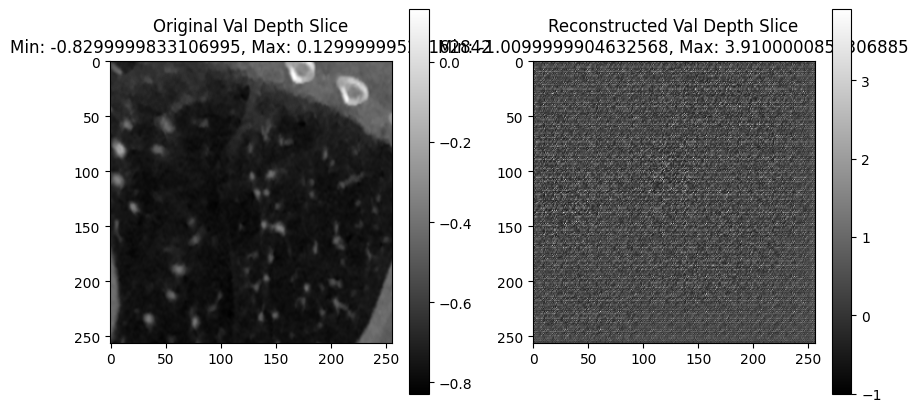

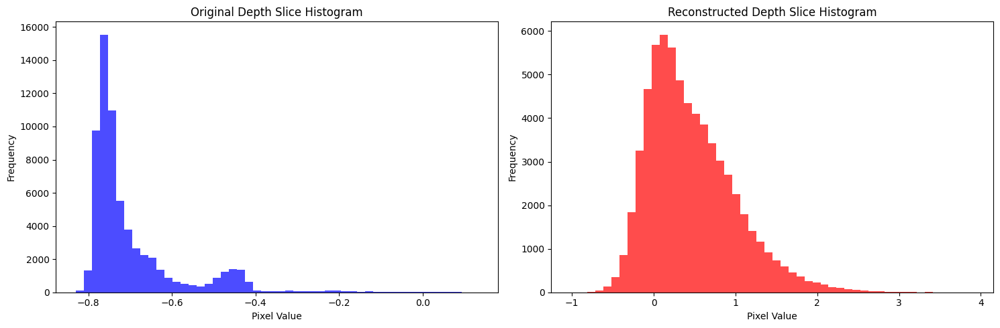

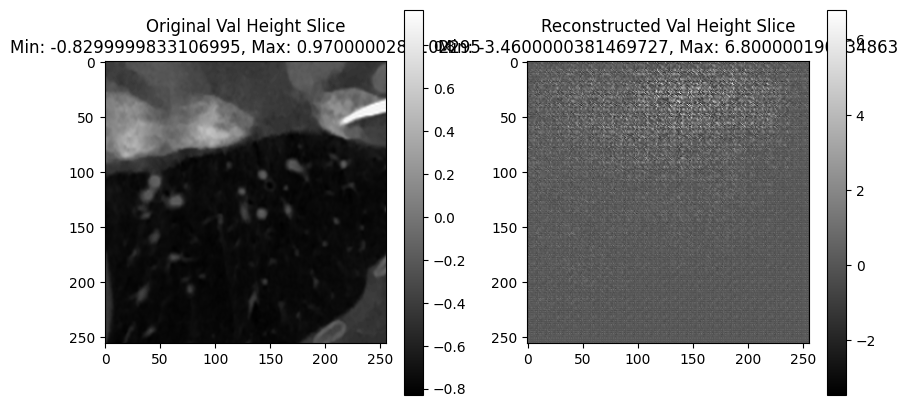

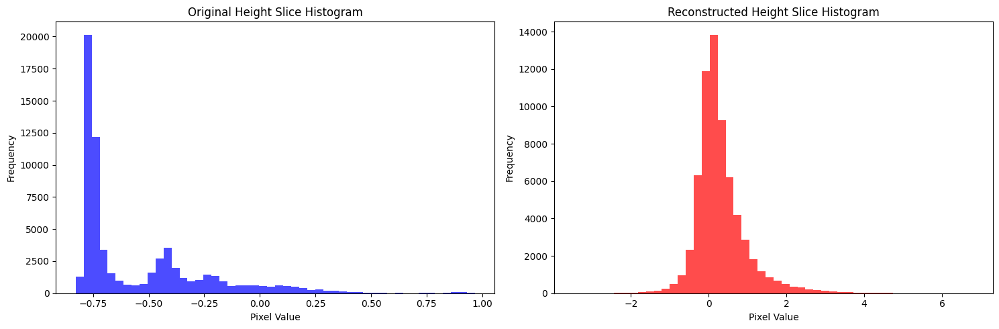

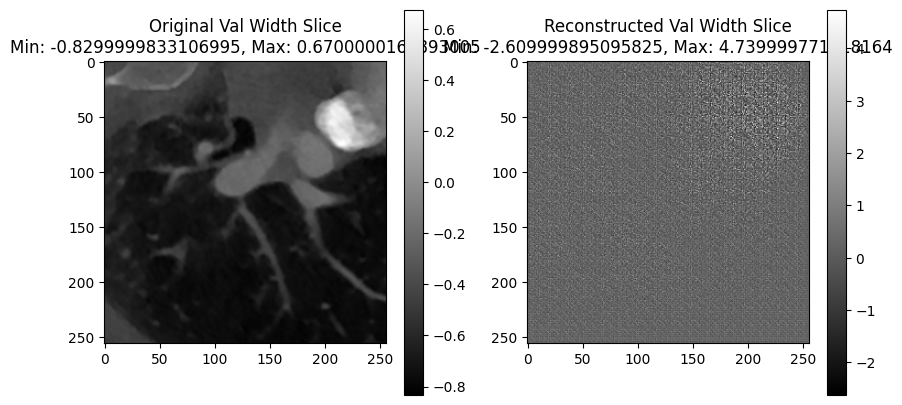

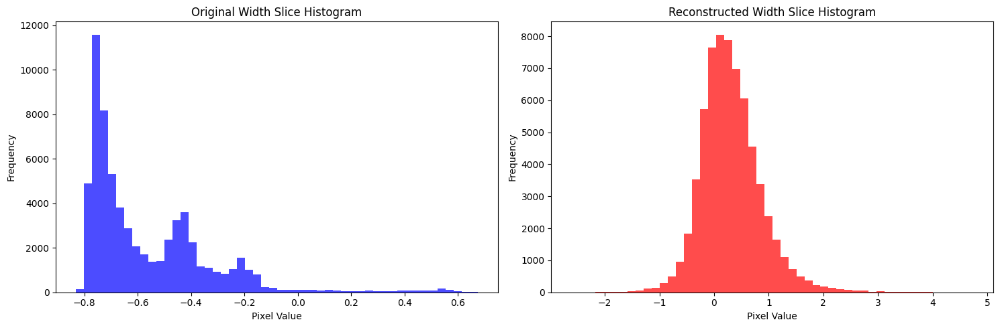

/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=63` in the `DataLoader` to improve performance.
/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (14) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

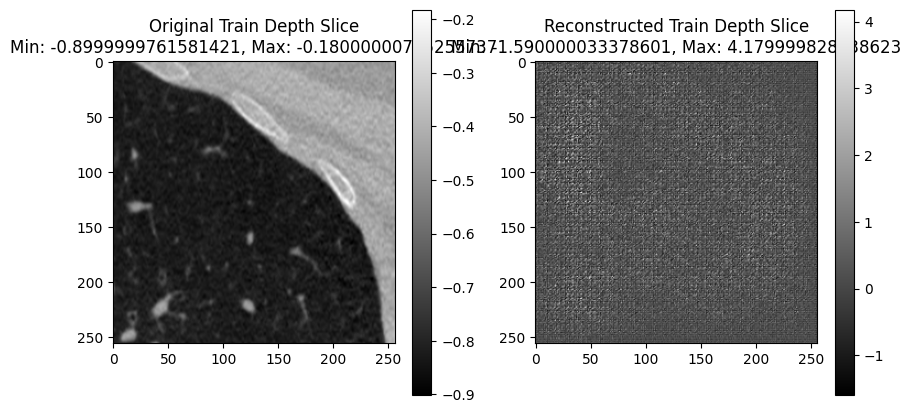

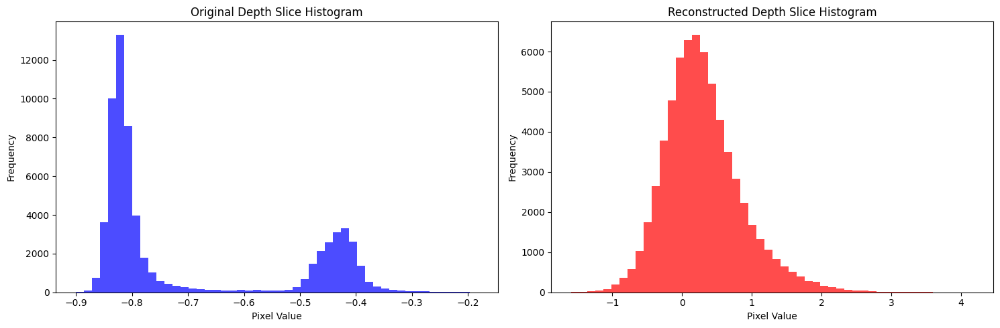

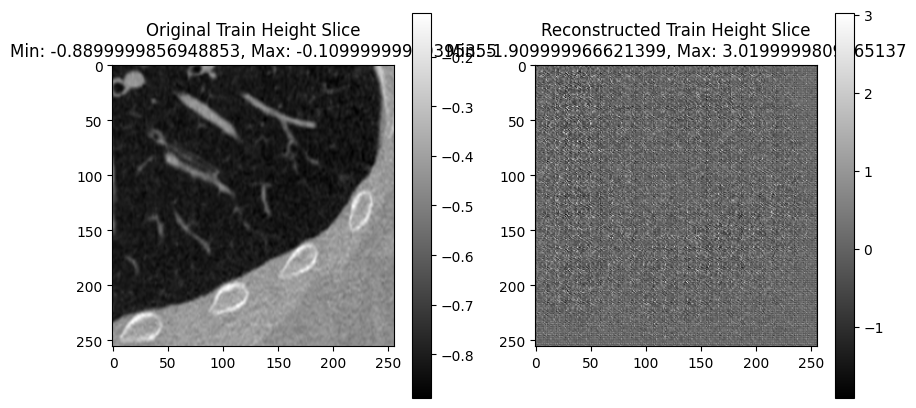

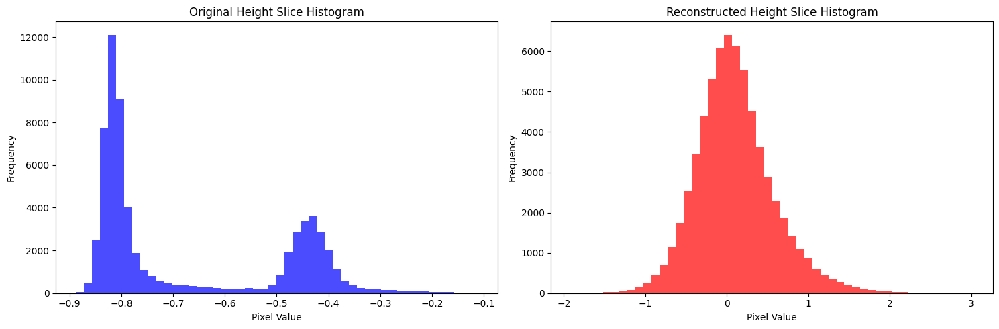

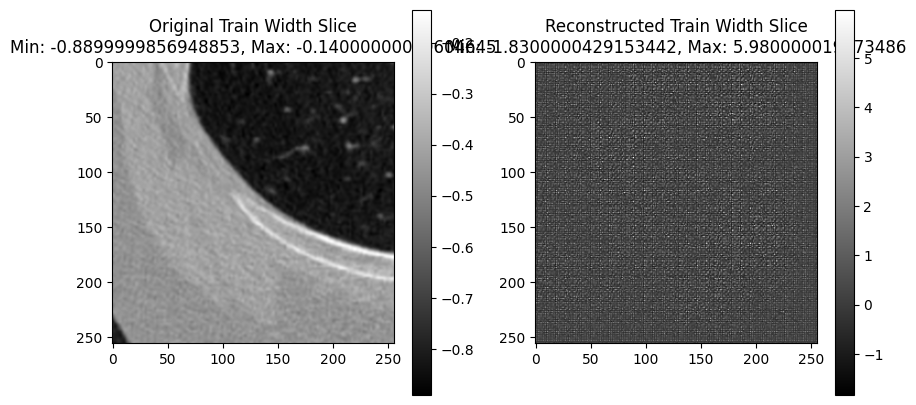

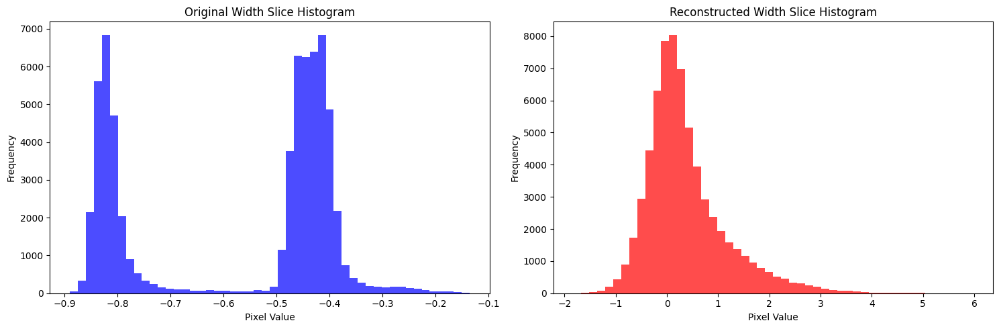

Validation: |          | 0/? [00:00<?, ?it/s]

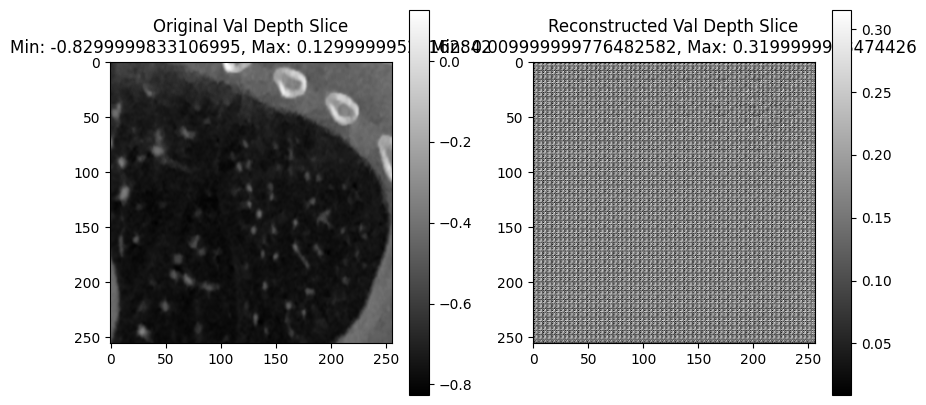

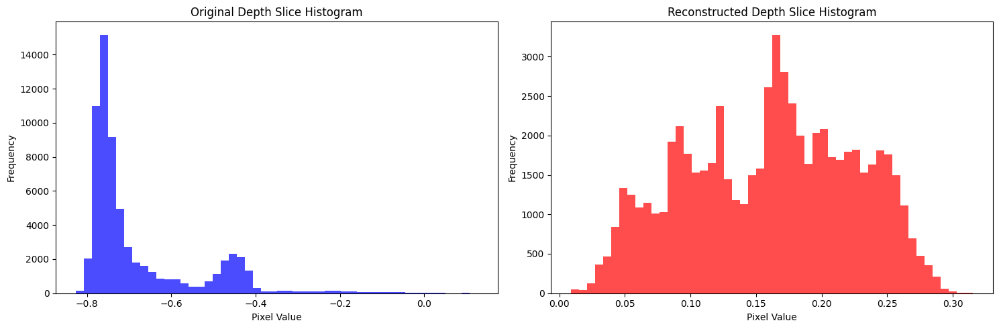

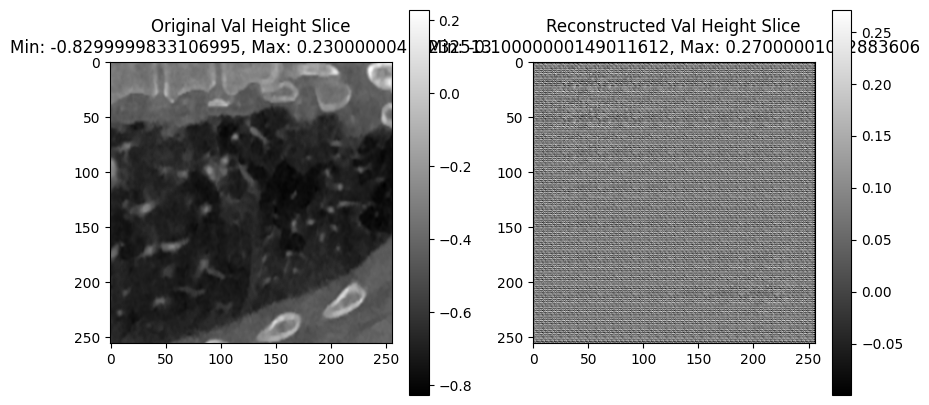

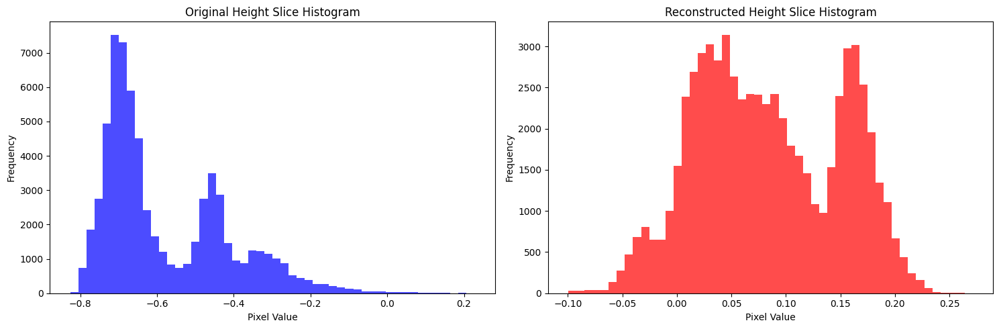

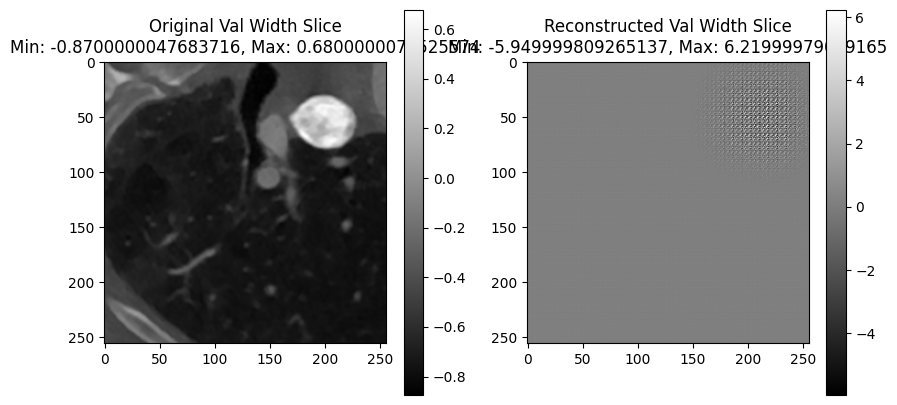

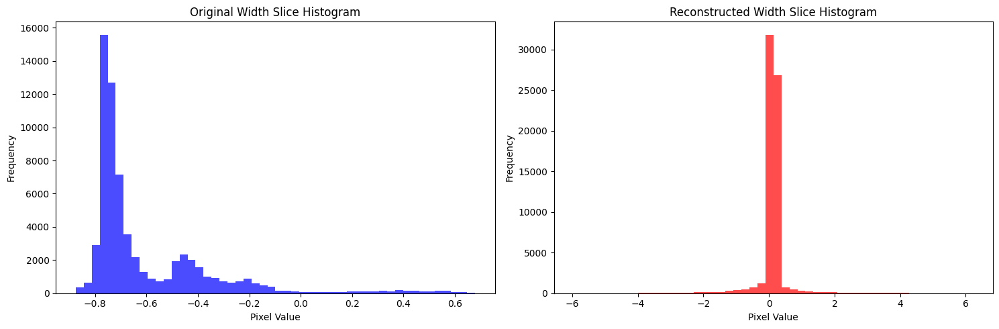

Time Spent 279.48
Epoch: 1


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 291.23
Epoch: 2


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 302.97
Epoch: 3


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 314.81
Epoch: 4


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 326.69
Epoch: 5


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 338.95
Epoch: 6


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 351.20
Epoch: 7


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 363.54
Epoch: 8


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 375.56
Epoch: 9


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 387.30
Epoch: 10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 399.60
Epoch: 11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 411.84
Epoch: 12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 426.92
Epoch: 13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 439.37
Epoch: 14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 452.01
Epoch: 15


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 463.78
Epoch: 16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 475.68
Epoch: 17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 488.03
Epoch: 18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 500.27
Epoch: 19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 512.04
Epoch: 20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 523.82
Epoch: 21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 535.83
Epoch: 22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 548.09
Epoch: 23


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 560.32
Epoch: 24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 572.70
Epoch: 25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 585.06
Epoch: 26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 597.11
Epoch: 27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 608.87
Epoch: 28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 620.71
Epoch: 29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 632.45
Epoch: 30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 644.19
Epoch: 31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 656.06
Epoch: 32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 667.92
Epoch: 33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 679.64
Epoch: 34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 691.37
Epoch: 35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 703.23
Epoch: 36


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 715.14
Epoch: 37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 727.11
Epoch: 38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 739.05
Epoch: 39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 751.39
Epoch: 40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 763.63
Epoch: 41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 775.70
Epoch: 42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 787.93
Epoch: 43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 800.21
Epoch: 44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 811.94
Epoch: 45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 823.77
Epoch: 46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 836.13
Epoch: 47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 847.91
Epoch: 48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 859.64
Epoch: 49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 871.61
Epoch: 50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 883.85
Epoch: 51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 896.10
Epoch: 52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 908.22
Epoch: 53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 920.08
Epoch: 54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 931.81
Epoch: 55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 943.66
Epoch: 56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 956.03
Epoch: 57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 968.00
Epoch: 58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 979.73
Epoch: 59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 991.61
Epoch: 60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1003.95
Epoch: 61


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1016.07
Epoch: 62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1027.82
Epoch: 63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1039.56
Epoch: 64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1051.38
Epoch: 65


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1063.11
Epoch: 66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1074.82
Epoch: 67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1086.66
Epoch: 68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1098.37
Epoch: 69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1110.08
Epoch: 70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1121.95
Epoch: 71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1136.04
Epoch: 72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1147.76
Epoch: 73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1159.49
Epoch: 74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1171.33
Epoch: 75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1183.06
Epoch: 76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1194.85
Epoch: 77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1206.58
Epoch: 78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1218.41
Epoch: 79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1230.14
Epoch: 80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1241.86
Epoch: 81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1253.59
Epoch: 82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1265.47
Epoch: 83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1277.20
Epoch: 84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1288.93
Epoch: 85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1300.99
Epoch: 86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1313.23
Epoch: 87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1325.46
Epoch: 88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1337.69
Epoch: 89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1350.07
Epoch: 90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1362.04
Epoch: 91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1374.29
Epoch: 92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1386.15
Epoch: 93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1397.87
Epoch: 94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1409.59
Epoch: 95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1421.33
Epoch: 96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1433.36
Epoch: 97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1445.10
Epoch: 98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1456.83
Epoch: 99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1468.69
Epoch: 100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1480.43
Epoch: 101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1492.17
Epoch: 102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1503.90
Epoch: 103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1515.73
Epoch: 104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1527.47
Epoch: 105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1539.19
Epoch: 106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1550.91
Epoch: 107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1562.73
Epoch: 108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1574.86
Epoch: 109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1587.10
Epoch: 110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1599.52
Epoch: 111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1611.76
Epoch: 112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1623.99
Epoch: 113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1636.24
Epoch: 114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1648.59
Epoch: 115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1660.82
Epoch: 116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1673.09
Epoch: 117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1684.96
Epoch: 118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1696.70
Epoch: 119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1708.44
Epoch: 120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1720.41
Epoch: 121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1732.73
Epoch: 122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1744.54
Epoch: 123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1756.26
Epoch: 124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1768.10
Epoch: 125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1779.83
Epoch: 126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1791.58
Epoch: 127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1803.29
Epoch: 128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1815.18
Epoch: 129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1826.90
Epoch: 130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1838.92
Epoch: 131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1850.65
Epoch: 132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1862.47
Epoch: 133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1874.19
Epoch: 134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1885.91
Epoch: 135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1897.74
Epoch: 136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1909.46
Epoch: 137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1921.42
Epoch: 138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1933.67
Epoch: 139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1946.04
Epoch: 140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1958.26
Epoch: 141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1970.51
Epoch: 142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1982.84
Epoch: 143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1995.06
Epoch: 144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2007.30
Epoch: 145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2019.28
Epoch: 146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2031.49
Epoch: 147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2043.27
Epoch: 148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2055.45
Epoch: 149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2067.91
Epoch: 150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2080.49
Epoch: 151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2092.74
Epoch: 152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2104.55
Epoch: 153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2116.39
Epoch: 154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2128.11
Epoch: 155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2139.83
Epoch: 156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2151.55
Epoch: 157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2163.83
Epoch: 158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2176.07
Epoch: 159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2188.33
Epoch: 160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2200.20
Epoch: 161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2212.19
Epoch: 162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2224.00
Epoch: 163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2235.73
Epoch: 164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2247.64
Epoch: 165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2259.63
Epoch: 166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2271.85
Epoch: 167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2283.69
Epoch: 168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2295.41
Epoch: 169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2307.24
Epoch: 170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2319.03
Epoch: 171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2330.88
Epoch: 172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2343.04
Epoch: 173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2354.79
Epoch: 174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2366.65
Epoch: 175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2378.40
Epoch: 176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2390.14
Epoch: 177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2402.26
Epoch: 178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2414.62
Epoch: 179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2426.62
Epoch: 180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2438.87
Epoch: 181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2450.86
Epoch: 182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2463.13
Epoch: 183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2474.86
Epoch: 184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2486.59
Epoch: 185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2498.64
Epoch: 186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2510.64
Epoch: 187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2522.85
Epoch: 188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2535.11
Epoch: 189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2547.45
Epoch: 190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2559.68
Epoch: 191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2571.92
Epoch: 192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2584.28
Epoch: 193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2596.53
Epoch: 194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2608.77
Epoch: 195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2621.04
Epoch: 196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2633.19
Epoch: 197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2644.92
Epoch: 198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2656.63
Epoch: 199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2668.78
Epoch: 200


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2681.29
Epoch: 201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2693.36
Epoch: 202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2705.61
Epoch: 203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2717.96
Epoch: 204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2730.20
Epoch: 205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2742.44
Epoch: 206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2754.61
Epoch: 207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2766.80
Epoch: 208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2779.05
Epoch: 209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2791.29
Epoch: 210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2803.16
Epoch: 211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2814.89
Epoch: 212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2826.64
Epoch: 213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2838.37
Epoch: 214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2850.18
Epoch: 215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2862.24
Epoch: 216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2874.47
Epoch: 217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2886.82
Epoch: 218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2899.09
Epoch: 219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2911.32
Epoch: 220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2923.57
Epoch: 221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2936.27
Epoch: 222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2948.02
Epoch: 223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2959.76
Epoch: 224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2971.61
Epoch: 225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2983.33
Epoch: 226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2995.05
Epoch: 227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3006.78
Epoch: 228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3018.95
Epoch: 229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3031.19
Epoch: 230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3043.44
Epoch: 231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3055.32
Epoch: 232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3067.66
Epoch: 233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3079.89
Epoch: 234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3092.13
Epoch: 235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3104.00
Epoch: 236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3115.89
Epoch: 237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3127.81
Epoch: 238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3139.55
Epoch: 239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3151.39
Epoch: 240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3163.12
Epoch: 241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3174.86
Epoch: 242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3186.70
Epoch: 243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3198.45
Epoch: 244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3210.41
Epoch: 245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3222.62
Epoch: 246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3236.95
Epoch: 247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3249.00
Epoch: 248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3263.69
Epoch: 249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3278.01
Epoch: 250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3289.95
Epoch: 251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3303.98
Epoch: 252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3319.51
Epoch: 253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3331.35
Epoch: 254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3343.25
Epoch: 255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3358.62
Epoch: 256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3370.87
Epoch: 257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3383.26
Epoch: 258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3395.50
Epoch: 259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3407.75
Epoch: 260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3419.79
Epoch: 261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3431.61
Epoch: 262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3443.62
Epoch: 263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3455.34
Epoch: 264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3467.17
Epoch: 265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3479.17
Epoch: 266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3491.03
Epoch: 267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3502.84
Epoch: 268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3514.55
Epoch: 269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3526.25
Epoch: 270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3537.96
Epoch: 271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3549.76
Epoch: 272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3561.47
Epoch: 273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3573.17
Epoch: 274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3584.99
Epoch: 275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3596.93
Epoch: 276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3608.65
Epoch: 277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3620.37
Epoch: 278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3632.45
Epoch: 279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3644.19
Epoch: 280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3655.99
Epoch: 281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3667.71
Epoch: 282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3679.54
Epoch: 283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3691.52
Epoch: 284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3703.24
Epoch: 285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3715.07
Epoch: 286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3726.79
Epoch: 287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3738.51
Epoch: 288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3750.23
Epoch: 289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3762.06
Epoch: 290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3773.84
Epoch: 291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3785.93
Epoch: 292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3798.31
Epoch: 293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3810.61
Epoch: 294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3822.84
Epoch: 295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3834.57
Epoch: 296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3846.62
Epoch: 297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3858.86
Epoch: 298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3871.11
Epoch: 299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3883.01
Epoch: 300


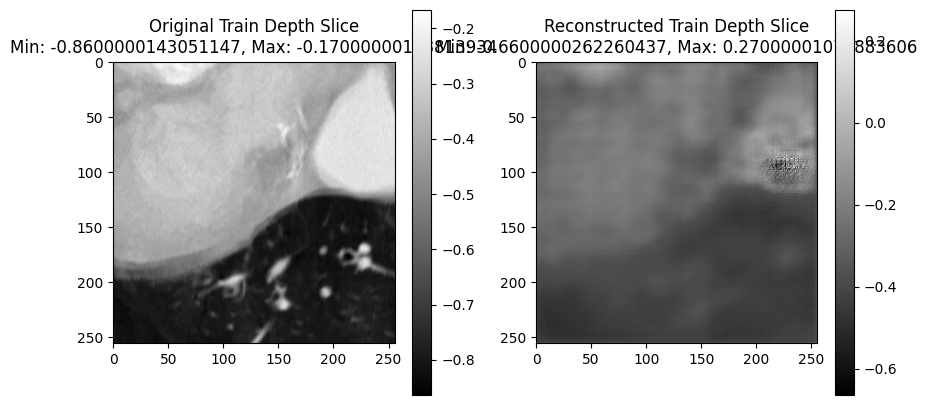

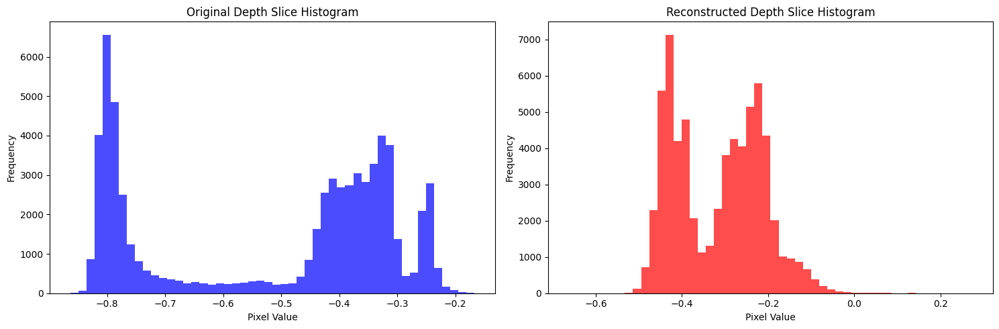

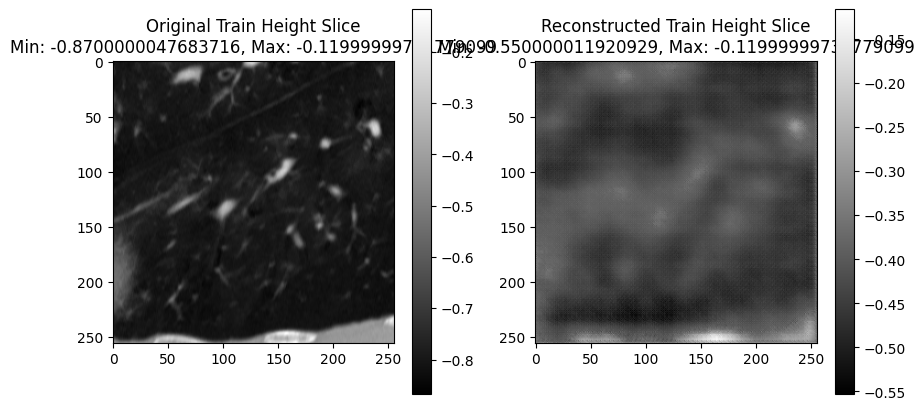

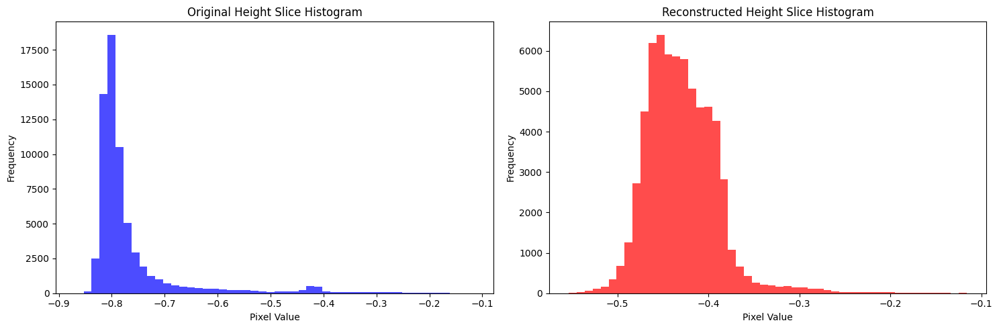

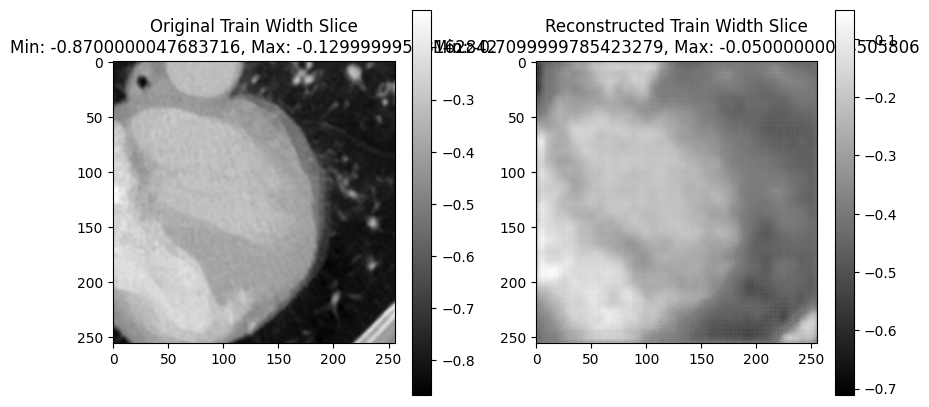

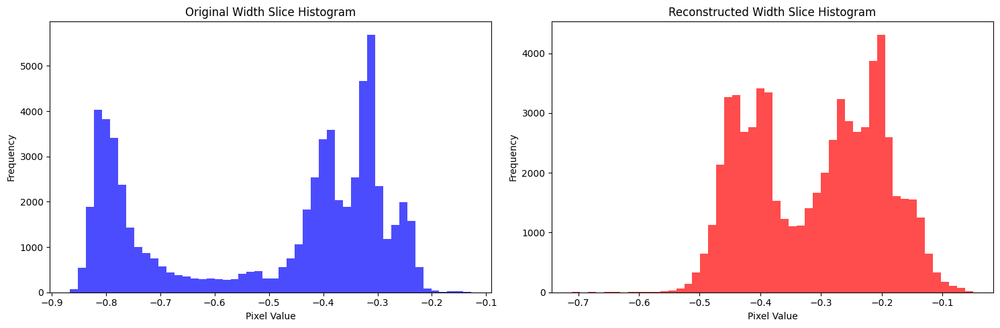

Validation: |          | 0/? [00:00<?, ?it/s]

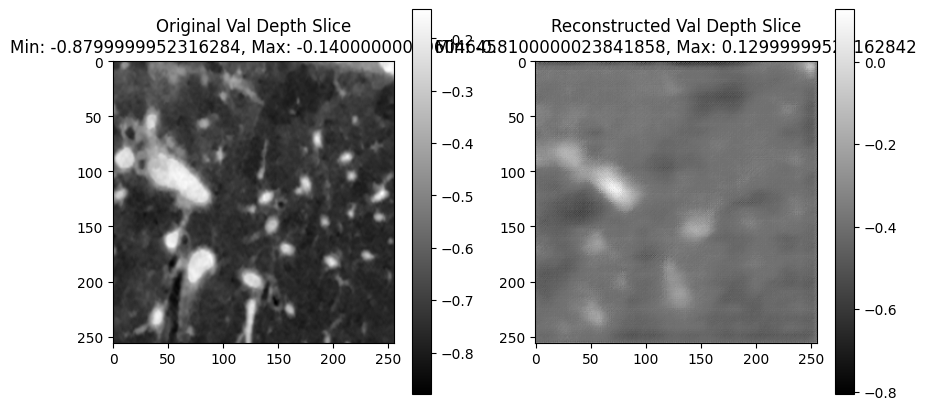

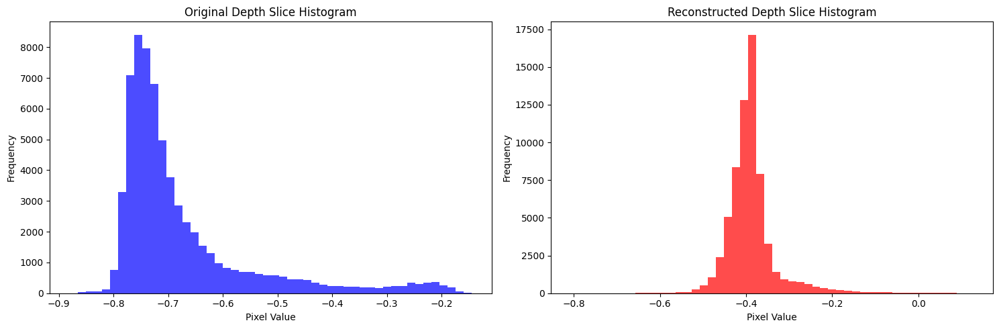

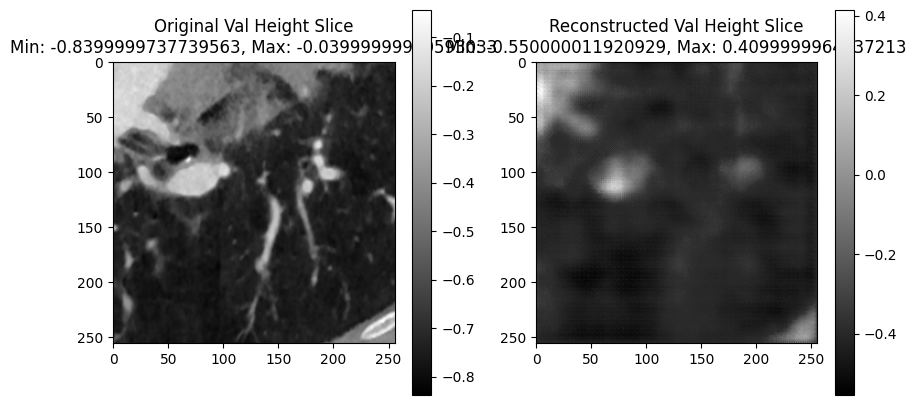

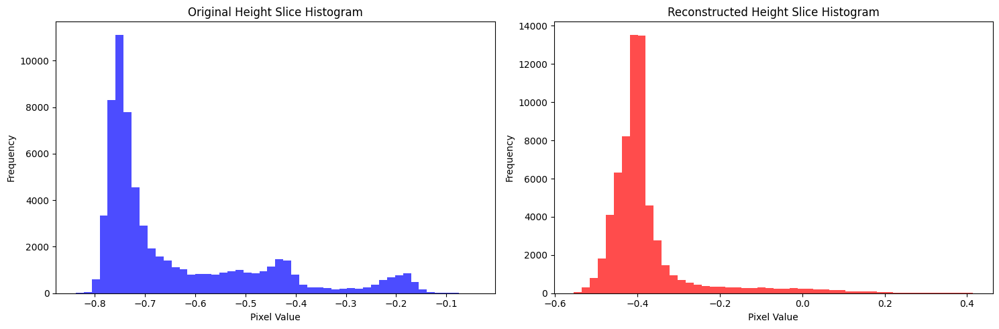

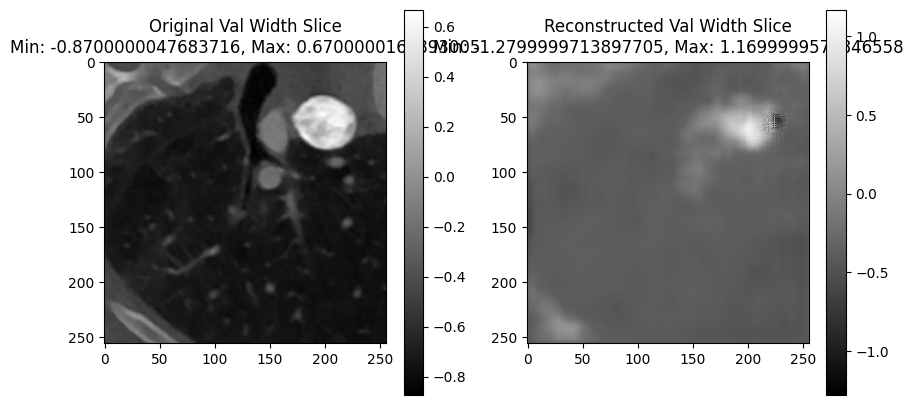

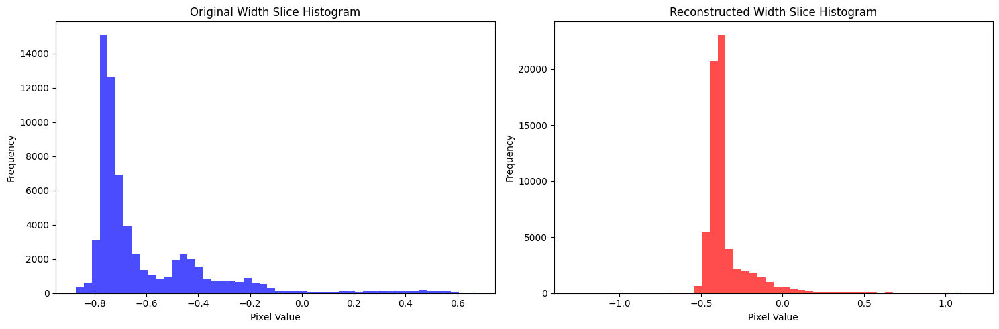

Time Spent 3901.49
Epoch: 301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3913.22
Epoch: 302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3924.96
Epoch: 303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3936.78
Epoch: 304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3948.50
Epoch: 305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3960.55
Epoch: 306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3972.42
Epoch: 307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3984.24
Epoch: 308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3996.16
Epoch: 309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4008.38
Epoch: 310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4020.71
Epoch: 311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4032.96
Epoch: 312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4045.21
Epoch: 313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4057.45
Epoch: 314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4069.78
Epoch: 315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4081.77
Epoch: 316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4093.72
Epoch: 317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4106.08
Epoch: 318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4118.30
Epoch: 319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4130.15
Epoch: 320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4142.24
Epoch: 321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4154.59
Epoch: 322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4166.83
Epoch: 323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4178.60
Epoch: 324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4190.47
Epoch: 325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4202.20
Epoch: 326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4213.93
Epoch: 327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4225.64
Epoch: 328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4237.47
Epoch: 329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4249.18
Epoch: 330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4260.94
Epoch: 331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4272.66
Epoch: 332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4284.48
Epoch: 333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4296.20
Epoch: 334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4307.94
Epoch: 335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4320.12
Epoch: 336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4332.35
Epoch: 337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4344.58
Epoch: 338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4356.82
Epoch: 339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4369.18
Epoch: 340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4381.25
Epoch: 341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4393.49
Epoch: 342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4405.85
Epoch: 343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4418.10
Epoch: 344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4430.29
Epoch: 345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4442.52
Epoch: 346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4454.88
Epoch: 347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4467.12
Epoch: 348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4479.11
Epoch: 349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4491.51
Epoch: 350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4503.37
Epoch: 351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4515.35
Epoch: 352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4527.59
Epoch: 353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4539.97
Epoch: 354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4552.21
Epoch: 355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4563.99
Epoch: 356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4575.98
Epoch: 357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4588.30
Epoch: 358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4600.54
Epoch: 359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4612.75
Epoch: 360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4624.64
Epoch: 361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4636.37
Epoch: 362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4648.09
Epoch: 363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4659.82
Epoch: 364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4671.65
Epoch: 365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4683.43
Epoch: 366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4695.31
Epoch: 367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4707.67
Epoch: 368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4719.91
Epoch: 369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4732.16
Epoch: 370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4744.11
Epoch: 371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4756.12
Epoch: 372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4768.34
Epoch: 373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4780.55
Epoch: 374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4792.92
Epoch: 375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4805.14
Epoch: 376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4817.39
Epoch: 377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4829.60
Epoch: 378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4841.96
Epoch: 379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4853.73
Epoch: 380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4865.98
Epoch: 381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4877.79
Epoch: 382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4890.15
Epoch: 383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4902.39
Epoch: 384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4914.30
Epoch: 385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4926.39
Epoch: 386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4938.61
Epoch: 387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4950.85
Epoch: 388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4963.10
Epoch: 389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4975.20
Epoch: 390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4986.94
Epoch: 391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4998.66
Epoch: 392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5010.48
Epoch: 393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5022.19
Epoch: 394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5033.91
Epoch: 395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5045.98
Epoch: 396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5058.32
Epoch: 397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5070.54
Epoch: 398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5082.77
Epoch: 399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5094.87
Epoch: 400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5106.89
Epoch: 401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5118.87
Epoch: 402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5131.08
Epoch: 403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5143.41
Epoch: 404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5155.14
Epoch: 405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5166.85
Epoch: 406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5178.57
Epoch: 407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5190.65
Epoch: 408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5202.89
Epoch: 409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5215.00
Epoch: 410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5226.86
Epoch: 411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5238.58
Epoch: 412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5250.30
Epoch: 413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5262.02
Epoch: 414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5273.90
Epoch: 415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5286.13
Epoch: 416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5298.36
Epoch: 417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5310.20
Epoch: 418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5321.92
Epoch: 419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5333.64
Epoch: 420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5345.36
Epoch: 421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5357.17
Epoch: 422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5368.89
Epoch: 423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5380.60
Epoch: 424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5392.44
Epoch: 425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5404.22
Epoch: 426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5415.95
Epoch: 427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5427.93
Epoch: 428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5440.27
Epoch: 429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5452.21
Epoch: 430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5464.38
Epoch: 431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5476.64
Epoch: 432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5488.75
Epoch: 433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5500.99
Epoch: 434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5513.22
Epoch: 435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5525.55
Epoch: 436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5537.77
Epoch: 437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5549.99
Epoch: 438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5562.23
Epoch: 439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5574.46
Epoch: 440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5586.72
Epoch: 441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5598.96
Epoch: 442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5611.31
Epoch: 443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5623.55
Epoch: 444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5635.77
Epoch: 445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5647.98
Epoch: 446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5659.84
Epoch: 447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5671.56
Epoch: 448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5683.29
Epoch: 449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5695.13
Epoch: 450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5706.86
Epoch: 451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5718.58
Epoch: 452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5730.57
Epoch: 453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5742.93
Epoch: 454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5754.95
Epoch: 455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5766.75
Epoch: 456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5778.50
Epoch: 457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5790.81
Epoch: 458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5803.06
Epoch: 459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5816.10
Epoch: 460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5828.52
Epoch: 461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5840.76
Epoch: 462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5852.54
Epoch: 463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5864.54
Epoch: 464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5876.41
Epoch: 465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5888.64
Epoch: 466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5900.72
Epoch: 467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5913.10
Epoch: 468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5925.38
Epoch: 469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5937.39
Epoch: 470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5949.13
Epoch: 471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5961.05
Epoch: 472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5973.00
Epoch: 473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5984.84
Epoch: 474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5996.93
Epoch: 475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6009.31
Epoch: 476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6021.40
Epoch: 477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6033.16
Epoch: 478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6045.22
Epoch: 479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6057.18
Epoch: 480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6069.41
Epoch: 481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6081.57
Epoch: 482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6093.70
Epoch: 483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6105.41
Epoch: 484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6117.27
Epoch: 485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6129.30
Epoch: 486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6141.60
Epoch: 487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6153.72
Epoch: 488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6166.06
Epoch: 489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6178.40
Epoch: 490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6190.14
Epoch: 491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6202.05
Epoch: 492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6213.86
Epoch: 493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6225.58
Epoch: 494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6237.51
Epoch: 495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6249.77
Epoch: 496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6262.47
Epoch: 497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6274.53
Epoch: 498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6286.72
Epoch: 499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6299.03
Epoch: 500


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6311.07
Epoch: 501


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6323.18
Epoch: 502


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6335.44
Epoch: 503


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6347.79
Epoch: 504


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6359.77
Epoch: 505


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6371.62
Epoch: 506


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6383.45
Epoch: 507


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6395.48
Epoch: 508


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6407.60
Epoch: 509


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6419.63
Epoch: 510


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6432.00
Epoch: 511


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6443.81
Epoch: 512


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6455.94
Epoch: 513


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6468.01
Epoch: 514


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6480.33
Epoch: 515


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6492.25
Epoch: 516


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6503.99
Epoch: 517


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6515.83
Epoch: 518


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6527.57
Epoch: 519


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6539.59
Epoch: 520


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6551.82
Epoch: 521


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6564.17
Epoch: 522


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6576.07
Epoch: 523


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6587.97
Epoch: 524


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6599.81
Epoch: 525


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6611.54
Epoch: 526


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6623.26
Epoch: 527


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6634.98
Epoch: 528


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6647.14
Epoch: 529


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6659.22
Epoch: 530


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6670.98
Epoch: 531


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6682.70
Epoch: 532


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6694.85
Epoch: 533


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6707.08
Epoch: 534


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6719.28
Epoch: 535


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6731.28
Epoch: 536


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6743.00
Epoch: 537


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6754.72
Epoch: 538


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6766.44
Epoch: 539


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6778.26
Epoch: 540


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6789.99
Epoch: 541


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6801.71
Epoch: 542


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6813.60
Epoch: 543


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6825.66
Epoch: 544


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6837.71
Epoch: 545


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6849.45
Epoch: 546


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6861.30
Epoch: 547


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6873.03
Epoch: 548


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6884.76
Epoch: 549


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6896.74
Epoch: 550


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6908.94
Epoch: 551


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6921.17
Epoch: 552


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6933.40
Epoch: 553


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6945.74
Epoch: 554


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6957.97
Epoch: 555


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6970.21
Epoch: 556


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6982.43
Epoch: 557


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6994.77
Epoch: 558


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7007.00
Epoch: 559


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7018.91
Epoch: 560


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7031.39
Epoch: 561


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7043.63
Epoch: 562


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7055.88
Epoch: 563


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7068.12
Epoch: 564


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7080.45
Epoch: 565


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7092.70
Epoch: 566


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7104.94
Epoch: 567


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7116.90
Epoch: 568


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7128.95
Epoch: 569


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7141.02
Epoch: 570


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7152.76
Epoch: 571


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7164.59
Epoch: 572


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7176.69
Epoch: 573


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7188.76
Epoch: 574


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7200.94
Epoch: 575


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7213.15
Epoch: 576


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7225.41
Epoch: 577


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7237.73
Epoch: 578


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7249.59
Epoch: 579


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7261.68
Epoch: 580


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7273.93
Epoch: 581


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7286.18
Epoch: 582


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7298.01
Epoch: 583


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7309.72
Epoch: 584


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7321.42
Epoch: 585


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7333.22
Epoch: 586


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7344.92
Epoch: 587


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7357.06
Epoch: 588


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7369.19
Epoch: 589


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7381.22
Epoch: 590


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7393.12
Epoch: 591


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7405.39
Epoch: 592


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7417.76
Epoch: 593


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7429.99
Epoch: 594


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7442.23
Epoch: 595


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7454.00
Epoch: 596


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7465.82
Epoch: 597


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7477.93
Epoch: 598


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7490.18
Epoch: 599


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7502.54
Epoch: 600


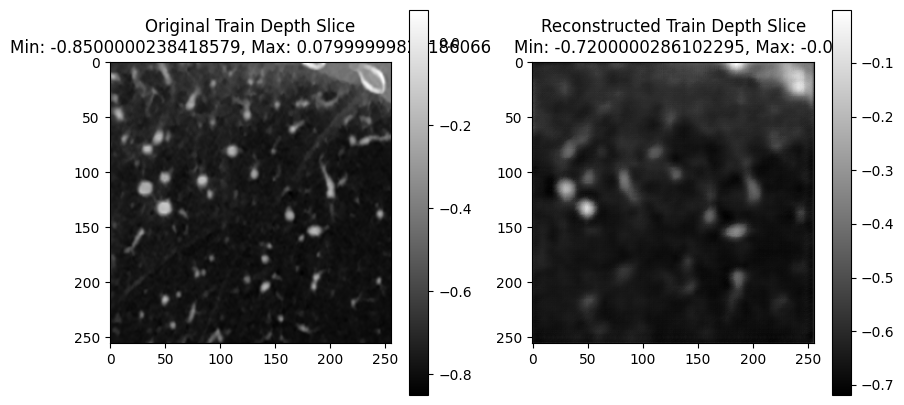

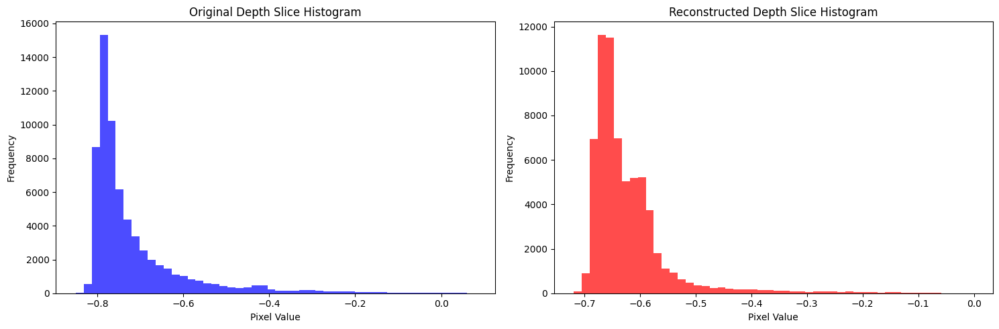

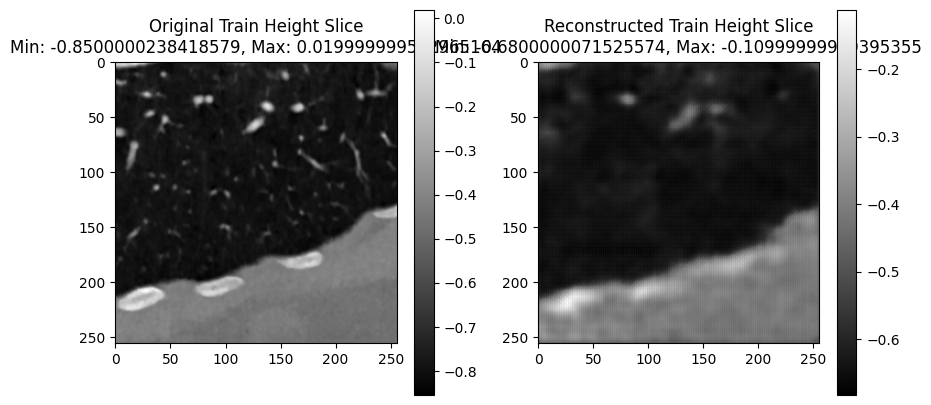

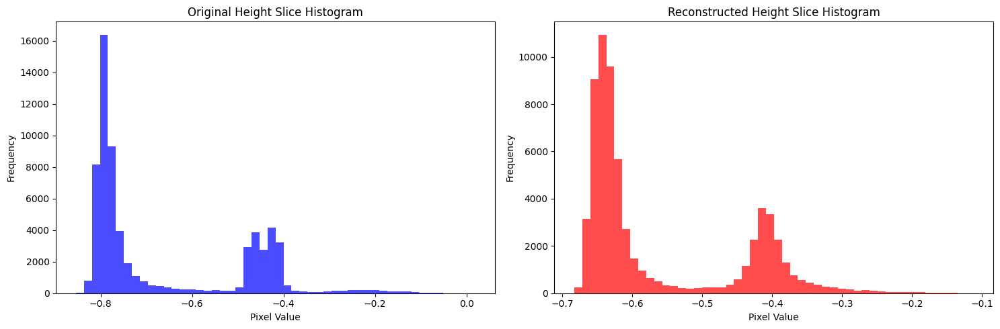

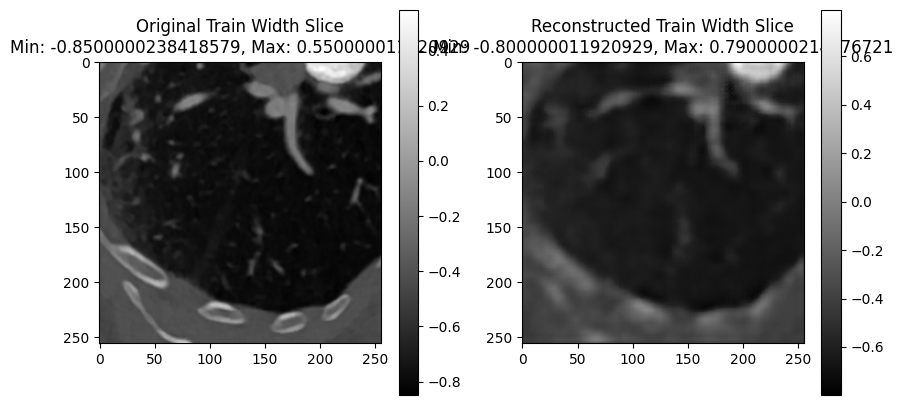

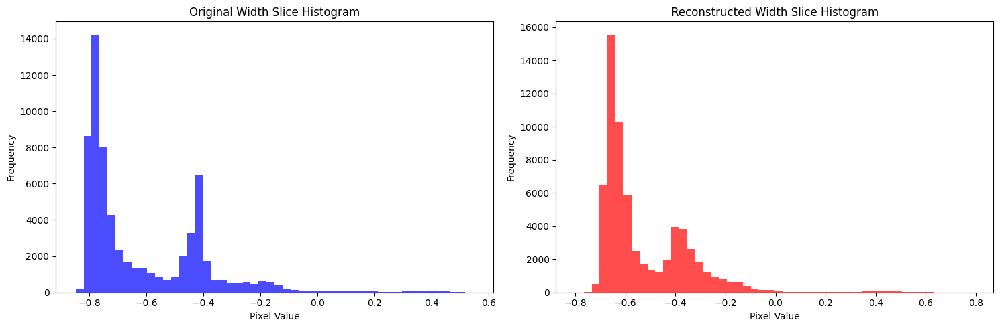

Validation: |          | 0/? [00:00<?, ?it/s]

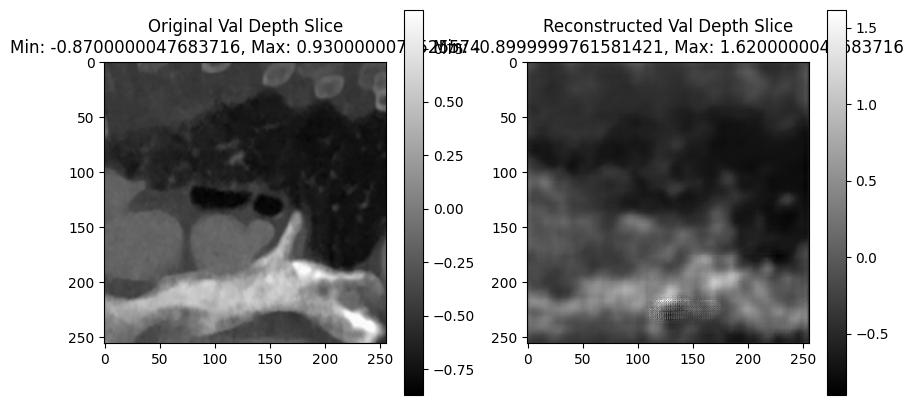

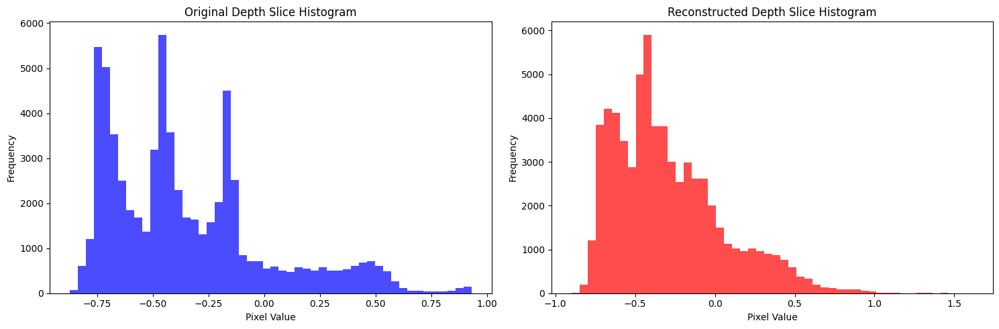

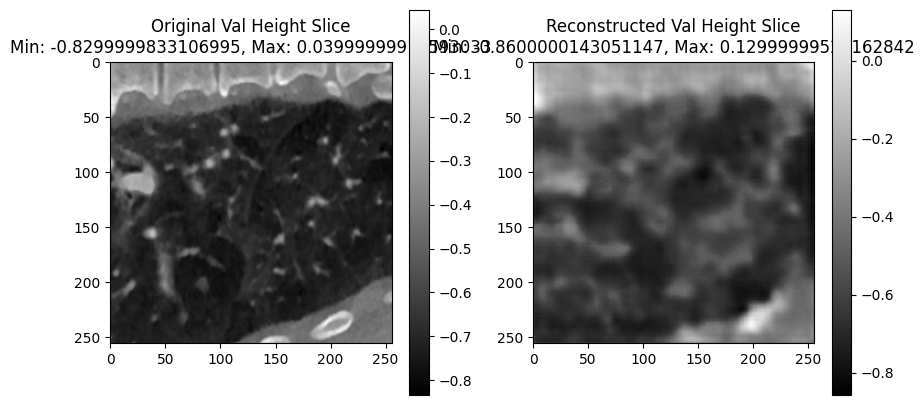

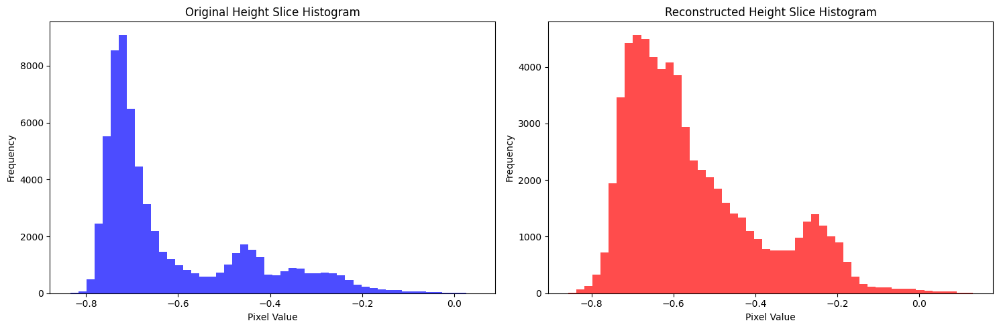

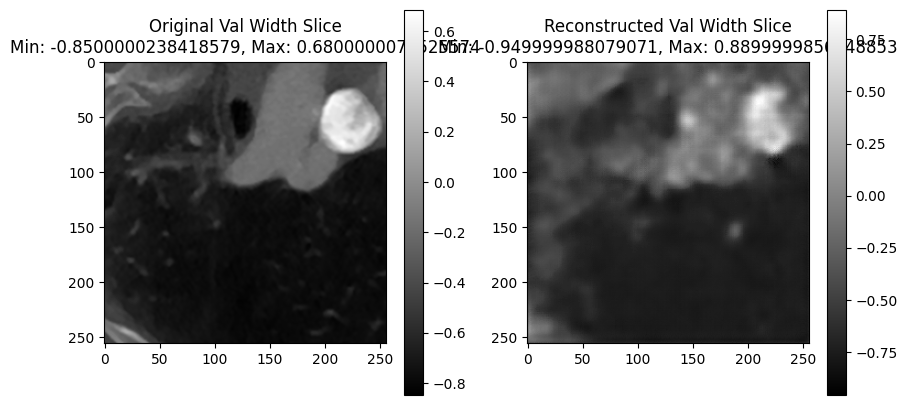

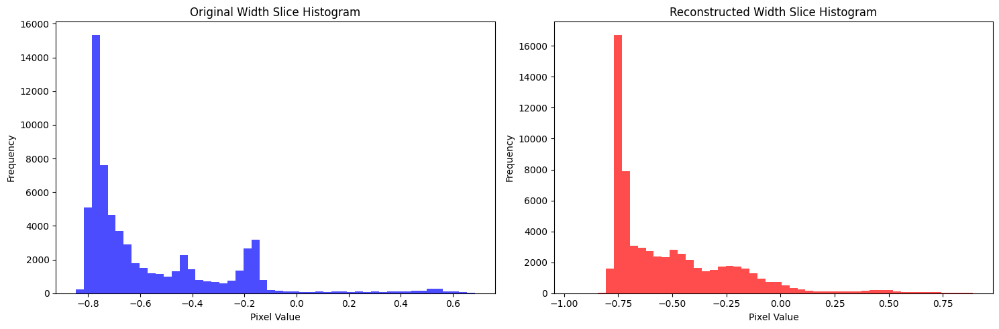

Time Spent 7521.31
Epoch: 601


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7533.26
Epoch: 602


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7545.50
Epoch: 603


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7557.50
Epoch: 604


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7569.54
Epoch: 605


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7581.78
Epoch: 606


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7594.02
Epoch: 607


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7606.39
Epoch: 608


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7618.63
Epoch: 609


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7630.87
Epoch: 610


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7642.74
Epoch: 611


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7654.49
Epoch: 612


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7666.22
Epoch: 613


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7678.33
Epoch: 614


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7690.68
Epoch: 615


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7702.96
Epoch: 616


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7715.20
Epoch: 617


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7727.56
Epoch: 618


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7739.80
Epoch: 619


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7752.05
Epoch: 620


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7764.26
Epoch: 621


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7776.63
Epoch: 622


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7788.89
Epoch: 623


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7801.12
Epoch: 624


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7813.15
Epoch: 625


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7824.87
Epoch: 626


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7836.59
Epoch: 627


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7848.33
Epoch: 628


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7860.57
Epoch: 629


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7872.81
Epoch: 630


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7884.56
Epoch: 631


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7896.30
Epoch: 632


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7908.50
Epoch: 633


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7920.74
Epoch: 634


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7932.63
Epoch: 635


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7944.88
Epoch: 636


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7957.10
Epoch: 637


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7969.33
Epoch: 638


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7981.57
Epoch: 639


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7993.49
Epoch: 640


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8005.29
Epoch: 641


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8017.44
Epoch: 642


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8029.83
Epoch: 643


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8041.72
Epoch: 644


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8053.45
Epoch: 645


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8065.61
Epoch: 646


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8077.97
Epoch: 647


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8090.21
Epoch: 648


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8102.27
Epoch: 649


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8114.18
Epoch: 650


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8125.91
Epoch: 651


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8137.63
Epoch: 652


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8149.33
Epoch: 653


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8161.14
Epoch: 654


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8172.86
Epoch: 655


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8184.58
Epoch: 656


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8196.29
Epoch: 657


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8208.09
Epoch: 658


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8219.79
Epoch: 659


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8231.96
Epoch: 660


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8244.31
Epoch: 661


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8256.53
Epoch: 662


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8268.77
Epoch: 663


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8281.02
Epoch: 664


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8293.37
Epoch: 665


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8305.20
Epoch: 666


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8316.96
Epoch: 667


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8328.80
Epoch: 668


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8340.57
Epoch: 669


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8352.30
Epoch: 670


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8364.03
Epoch: 671


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8376.35
Epoch: 672


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8388.53
Epoch: 673


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8400.26
Epoch: 674


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8412.31
Epoch: 675


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8424.56
Epoch: 676


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8436.80
Epoch: 677


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8449.05
Epoch: 678


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8461.22
Epoch: 679


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8473.27
Epoch: 680


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8484.99
Epoch: 681


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8496.71
Epoch: 682


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8508.54
Epoch: 683


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8520.61
Epoch: 684


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8532.84
Epoch: 685


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8545.32
Epoch: 686


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8557.56
Epoch: 687


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8569.31
Epoch: 688


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8581.03
Epoch: 689


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8592.86
Epoch: 690


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8605.10
Epoch: 691


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8617.34
Epoch: 692


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8629.67
Epoch: 693


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8641.91
Epoch: 694


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8654.16
Epoch: 695


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8666.40
Epoch: 696


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8678.25
Epoch: 697


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8690.41
Epoch: 698


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8702.64
Epoch: 699


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8715.00
Epoch: 700


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8726.95
Epoch: 701


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8738.66
Epoch: 702


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8750.39
Epoch: 703


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8762.25
Epoch: 704


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8773.98
Epoch: 705


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8785.71
Epoch: 706


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8797.43
Epoch: 707


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8809.26
Epoch: 708


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8821.33
Epoch: 709


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8833.56
Epoch: 710


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8845.90
Epoch: 711


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8858.14
Epoch: 712


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8870.37
Epoch: 713


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8882.22
Epoch: 714


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8894.06
Epoch: 715


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8905.93
Epoch: 716


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8918.18
Epoch: 717


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8930.53
Epoch: 718


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8942.37
Epoch: 719


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8954.13
Epoch: 720


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8966.29
Epoch: 721


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8978.64
Epoch: 722


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8990.88
Epoch: 723


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9002.73
Epoch: 724


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9014.73
Epoch: 725


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9026.97
Epoch: 726


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9039.20
Epoch: 727


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9051.44
Epoch: 728


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9063.79
Epoch: 729


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9076.03
Epoch: 730


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9088.28
Epoch: 731


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9100.52
Epoch: 732


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9112.88
Epoch: 733


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9125.13
Epoch: 734


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9137.37
Epoch: 735


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9149.73
Epoch: 736


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9162.08
Epoch: 737


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9174.23
Epoch: 738


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9185.96
Epoch: 739


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9197.98
Epoch: 740


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9210.19
Epoch: 741


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9222.44
Epoch: 742


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9234.79
Epoch: 743


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9247.02
Epoch: 744


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9259.27
Epoch: 745


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9271.56
Epoch: 746


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9283.91
Epoch: 747


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9296.15
Epoch: 748


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9308.39
Epoch: 749


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9320.76
Epoch: 750


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9332.50
Epoch: 751


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9344.22
Epoch: 752


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9355.95
Epoch: 753


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9367.77
Epoch: 754


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9379.50
Epoch: 755


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9391.22
Epoch: 756


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9403.67
Epoch: 757


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9416.03
Epoch: 758


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9428.27
Epoch: 759


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9440.52
Epoch: 760


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9452.88
Epoch: 761


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9465.13
Epoch: 762


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9477.10
Epoch: 763


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9489.34
Epoch: 764


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9501.67
Epoch: 765


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9513.94
Epoch: 766


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9526.19
Epoch: 767


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9538.54
Epoch: 768


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9550.29
Epoch: 769


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9562.00
Epoch: 770


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9573.71
Epoch: 771


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9585.52
Epoch: 772


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9597.24
Epoch: 773


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9609.42
Epoch: 774


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9621.77
Epoch: 775


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9633.99
Epoch: 776


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9646.23
Epoch: 777


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9658.21
Epoch: 778


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9670.05
Epoch: 779


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9682.25
Epoch: 780


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9694.47
Epoch: 781


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9706.70
Epoch: 782


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9718.93
Epoch: 783


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9730.85
Epoch: 784


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9742.92
Epoch: 785


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9754.81
Epoch: 786


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9766.93
Epoch: 787


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9778.67
Epoch: 788


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9790.78
Epoch: 789


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9803.13
Epoch: 790


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9815.37
Epoch: 791


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9827.60
Epoch: 792


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9839.50
Epoch: 793


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9851.74
Epoch: 794


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9864.03
Epoch: 795


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9876.32
Epoch: 796


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9888.65
Epoch: 797


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9900.89
Epoch: 798


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9912.61
Epoch: 799


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9924.45
Epoch: 800


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9936.58
Epoch: 801


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9948.34
Epoch: 802


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9960.41
Epoch: 803


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9972.23
Epoch: 804


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9984.44
Epoch: 805


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9996.75
Epoch: 806


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10009.06
Epoch: 807


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10021.39
Epoch: 808


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10033.13
Epoch: 809


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10044.91
Epoch: 810


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10057.22
Epoch: 811


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10069.46
Epoch: 812


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10081.38
Epoch: 813


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10093.12
Epoch: 814


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10105.42
Epoch: 815


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10117.66
Epoch: 816


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10129.68
Epoch: 817


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10141.72
Epoch: 818


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10154.03
Epoch: 819


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10166.28
Epoch: 820


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10178.53
Epoch: 821


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10190.88
Epoch: 822


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10203.18
Epoch: 823


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10215.04
Epoch: 824


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10226.88
Epoch: 825


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10238.60
Epoch: 826


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10250.31
Epoch: 827


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10262.42
Epoch: 828


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10274.78
Epoch: 829


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10287.02
Epoch: 830


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10299.30
Epoch: 831


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10311.59
Epoch: 832


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10324.11
Epoch: 833


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10336.45
Epoch: 834


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10348.96
Epoch: 835


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10361.92
Epoch: 836


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10376.69
Epoch: 837


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10389.02
Epoch: 838


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10401.81
Epoch: 839


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10414.30
Epoch: 840


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10426.55
Epoch: 841


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10438.79
Epoch: 842


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10451.68
Epoch: 843


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10464.21
Epoch: 844


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10476.12
Epoch: 845


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10487.94
Epoch: 846


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10500.48
Epoch: 847


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10512.75
Epoch: 848


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10525.01
Epoch: 849


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10539.59
Epoch: 850


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10551.62
Epoch: 851


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10570.12
Epoch: 852


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10585.29
Epoch: 853


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10600.93
Epoch: 854


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10616.22
Epoch: 855


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10627.96
Epoch: 856


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10641.91
Epoch: 857


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10655.60
Epoch: 858


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10667.36
Epoch: 859


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10679.41
Epoch: 860


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10691.74
Epoch: 861


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10704.15
Epoch: 862


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10715.99
Epoch: 863


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10728.20
Epoch: 864


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10740.54
Epoch: 865


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10752.84
Epoch: 866


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10764.83
Epoch: 867


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10777.03
Epoch: 868


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10789.75
Epoch: 869


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10802.15
Epoch: 870


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10814.63
Epoch: 871


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10827.18
Epoch: 872


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10842.61
Epoch: 873


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10857.65
Epoch: 874


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10879.37
Epoch: 875


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10914.07
Epoch: 876


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10947.84
Epoch: 877


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10962.74
Epoch: 878


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11002.20
Epoch: 879


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11024.20
Epoch: 880


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11038.29
Epoch: 881


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11057.75
Epoch: 882


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11071.72
Epoch: 883


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11108.41
Epoch: 884


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11122.32
Epoch: 885


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11134.65
Epoch: 886


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11146.89
Epoch: 887


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11159.14
Epoch: 888


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11171.38
Epoch: 889


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11183.88
Epoch: 890


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11196.12
Epoch: 891


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11208.38
Epoch: 892


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11220.74
Epoch: 893


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11232.98
Epoch: 894


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11244.92
Epoch: 895


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11256.65
Epoch: 896


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11268.49
Epoch: 897


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11280.26
Epoch: 898


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11292.00
Epoch: 899


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11303.84
Epoch: 900


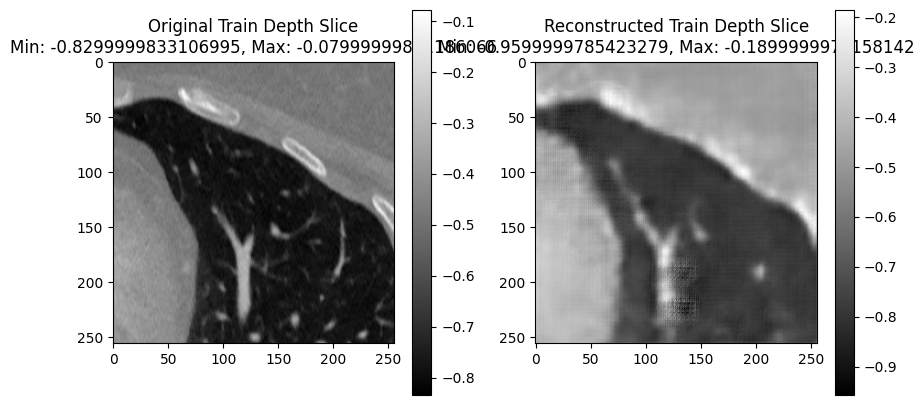

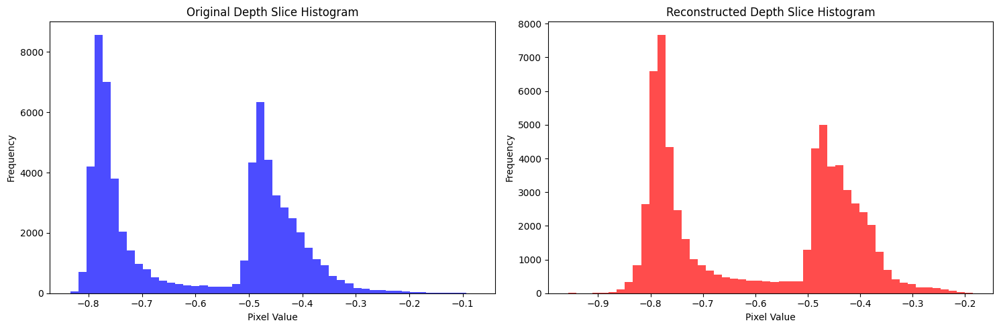

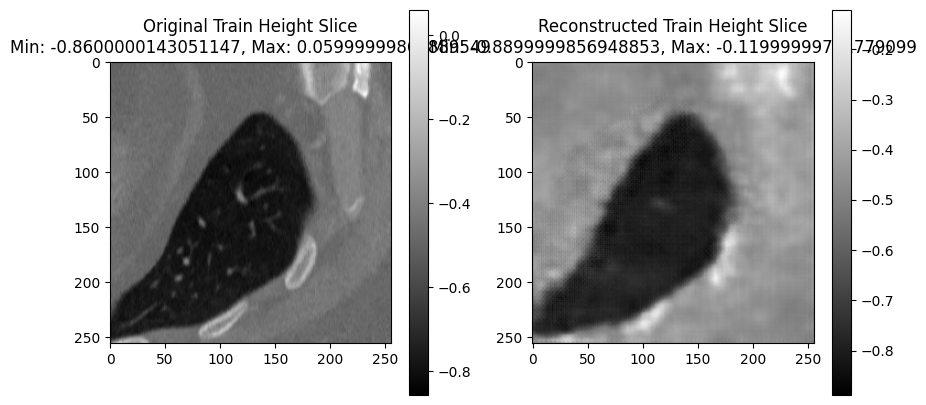

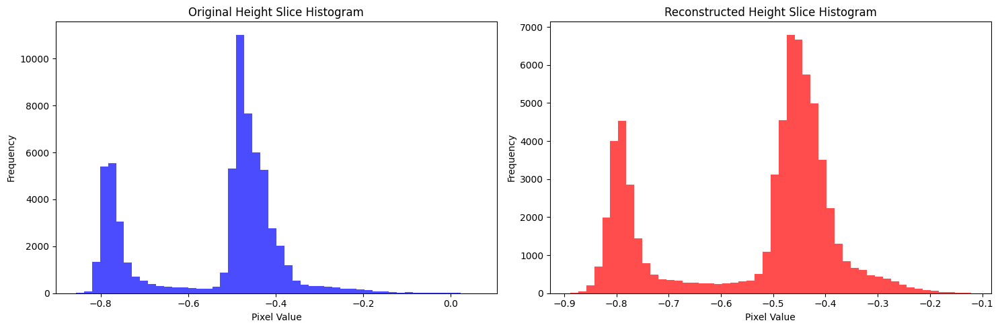

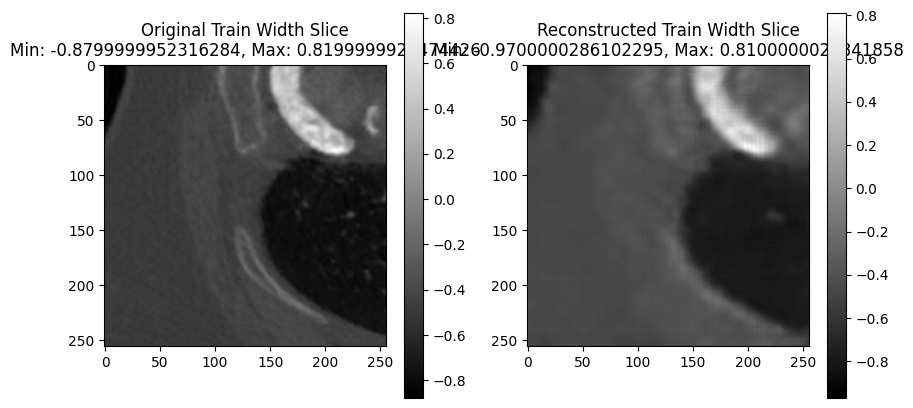

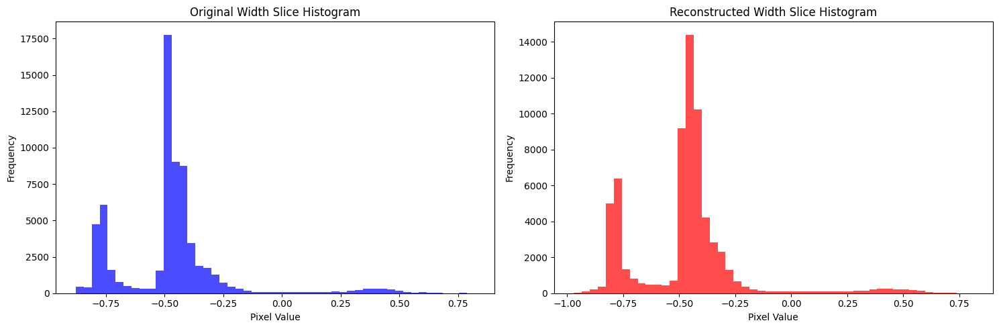

Validation: |          | 0/? [00:00<?, ?it/s]

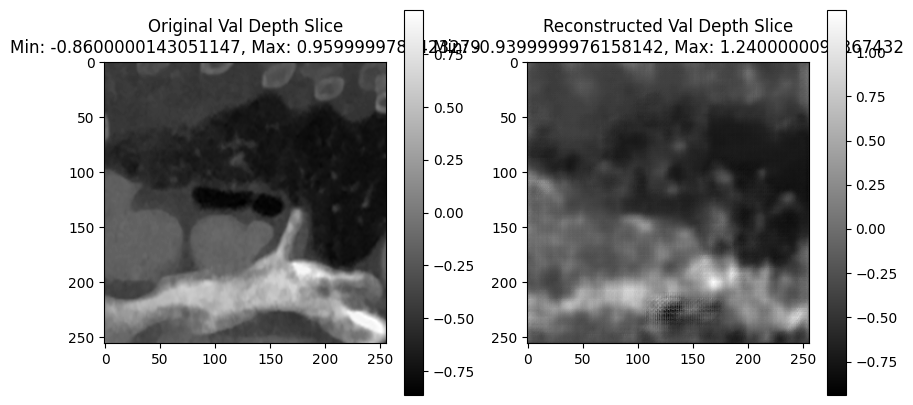

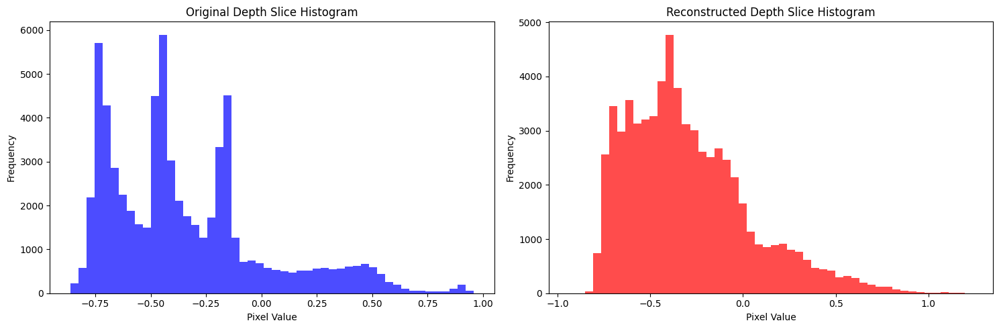

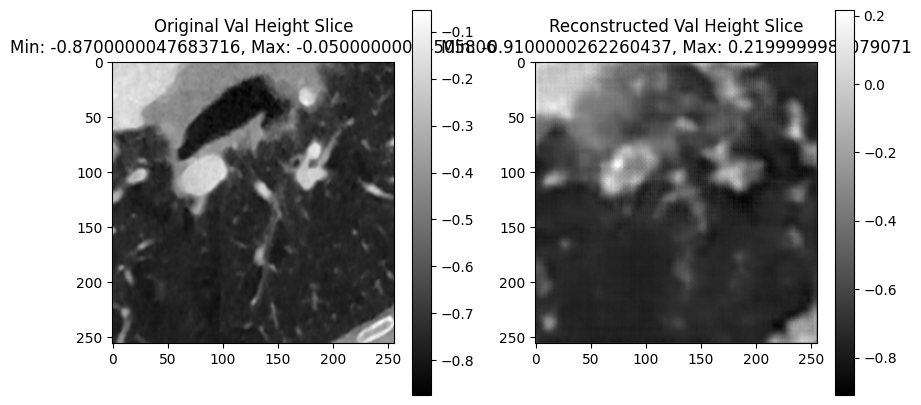

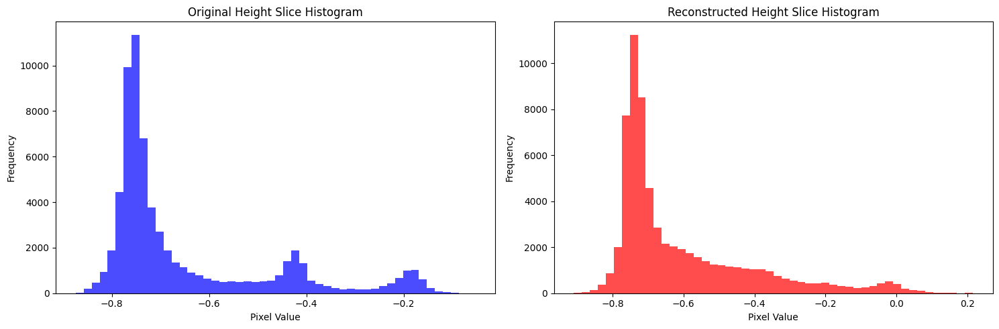

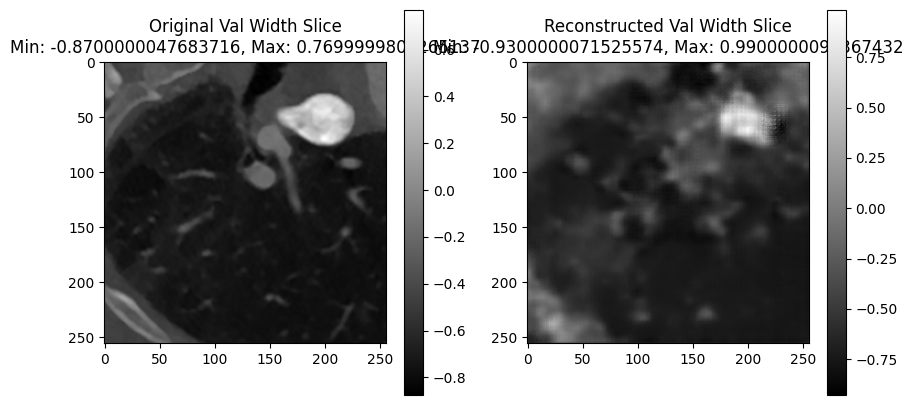

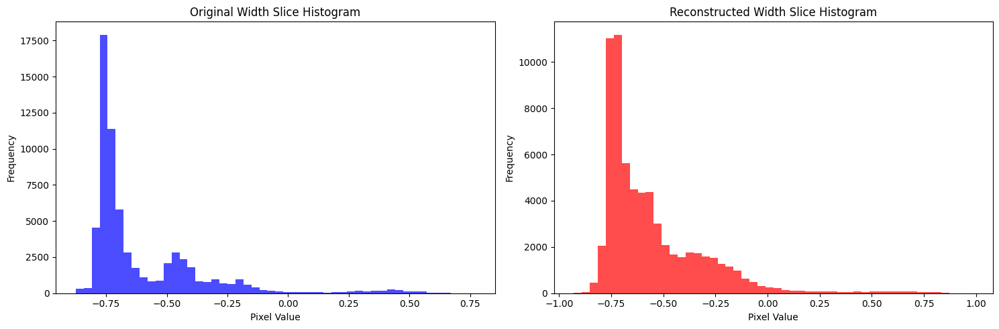

Time Spent 11322.50
Epoch: 901


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11334.58
Epoch: 902


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11346.46
Epoch: 903


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11358.35
Epoch: 904


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11370.11
Epoch: 905


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11382.16
Epoch: 906


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11393.96
Epoch: 907


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11406.34
Epoch: 908


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11418.61
Epoch: 909


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11430.97
Epoch: 910


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11443.40
Epoch: 911


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11455.64
Epoch: 912


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11467.87
Epoch: 913


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11479.59
Epoch: 914


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11491.45
Epoch: 915


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11503.56
Epoch: 916


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11515.45
Epoch: 917


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11527.70
Epoch: 918


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11539.95
Epoch: 919


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11552.19
Epoch: 920


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11564.43
Epoch: 921


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11576.55
Epoch: 922


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11588.29
Epoch: 923


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11600.02
Epoch: 924


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11611.86
Epoch: 925


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11623.57
Epoch: 926


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11635.51
Epoch: 927


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11647.73
Epoch: 928


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11660.11
Epoch: 929


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11672.37
Epoch: 930


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11684.61
Epoch: 931


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11696.72
Epoch: 932


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11708.56
Epoch: 933


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11720.33
Epoch: 934


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11732.05
Epoch: 935


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11743.87
Epoch: 936


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11755.80
Epoch: 937


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11770.67
Epoch: 938


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11787.54
Epoch: 939


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11863.86
Epoch: 940


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11876.22
Epoch: 941


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11888.45
Epoch: 942


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11900.79
Epoch: 943


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11913.02
Epoch: 944


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11924.83
Epoch: 945


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11936.87
Epoch: 946


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11948.73
Epoch: 947


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11961.03
Epoch: 948


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11973.28
Epoch: 949


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11985.15
Epoch: 950


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11997.08
Epoch: 951


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12009.35
Epoch: 952


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12021.59
Epoch: 953


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12033.92
Epoch: 954


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12046.15
Epoch: 955


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12058.42
Epoch: 956


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12070.67
Epoch: 957


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12082.52
Epoch: 958


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12094.33
Epoch: 959


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12106.13
Epoch: 960


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12118.01
Epoch: 961


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12129.73
Epoch: 962


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12141.95
Epoch: 963


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12154.19
Epoch: 964


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12166.53
Epoch: 965


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12178.31
Epoch: 966


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12190.10
Epoch: 967


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12201.92
Epoch: 968


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12213.65
Epoch: 969


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12225.51
Epoch: 970


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12237.46
Epoch: 971


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12249.44
Epoch: 972


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12261.56
Epoch: 973


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12273.89
Epoch: 974


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12286.38
Epoch: 975


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12299.39
Epoch: 976


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12454.07
Epoch: 977


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12469.43
Epoch: 978


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12484.44
Epoch: 979


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12499.32
Epoch: 980


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12514.31
Epoch: 981


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12530.07
Epoch: 982


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12544.97
Epoch: 983


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12557.32
Epoch: 984


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12569.56
Epoch: 985


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12583.60
Epoch: 986


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12595.34
Epoch: 987


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12607.09
Epoch: 988


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12620.85
Epoch: 989


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12632.69
Epoch: 990


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12644.41
Epoch: 991


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12656.57
Epoch: 992


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12668.93
Epoch: 993


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12681.15
Epoch: 994


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12693.39
Epoch: 995


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12705.30
Epoch: 996


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12717.65
Epoch: 997


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12729.89
Epoch: 998


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12742.15
Epoch: 999


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12754.61
Epoch: 1000


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12767.13
Epoch: 1001


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12779.07
Epoch: 1002


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12790.82
Epoch: 1003


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12802.64
Epoch: 1004


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12814.76
Epoch: 1005


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12826.49
Epoch: 1006


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12838.48
Epoch: 1007


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12850.69
Epoch: 1008


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12862.63
Epoch: 1009


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12874.42
Epoch: 1010


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12886.44
Epoch: 1011


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12898.67
Epoch: 1012


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12910.91
Epoch: 1013


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12923.15
Epoch: 1014


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12935.50
Epoch: 1015


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12947.74
Epoch: 1016


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12959.97
Epoch: 1017


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12972.33
Epoch: 1018


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12984.57
Epoch: 1019


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12996.81
Epoch: 1020


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13009.05
Epoch: 1021


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13021.43
Epoch: 1022


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13033.67
Epoch: 1023


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13045.91
Epoch: 1024


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13058.28
Epoch: 1025


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13070.52
Epoch: 1026


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13082.36
Epoch: 1027


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13094.09
Epoch: 1028


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13105.92
Epoch: 1029


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13118.10
Epoch: 1030


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13130.36
Epoch: 1031


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13142.60
Epoch: 1032


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13154.95
Epoch: 1033


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13167.04
Epoch: 1034


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13178.76
Epoch: 1035


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13190.59
Epoch: 1036


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13202.31
Epoch: 1037


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13214.21
Epoch: 1038


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13225.98
Epoch: 1039


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13237.81
Epoch: 1040


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13249.53
Epoch: 1041


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13261.31
Epoch: 1042


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13273.36
Epoch: 1043


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13285.61
Epoch: 1044


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13297.85
Epoch: 1045


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13310.11
Epoch: 1046


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13322.45
Epoch: 1047


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13334.59
Epoch: 1048


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13346.84
Epoch: 1049


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13359.21
Epoch: 1050


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13371.41
Epoch: 1051


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13383.64
Epoch: 1052


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13395.89
Epoch: 1053


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13408.24
Epoch: 1054


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13420.49
Epoch: 1055


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13432.74
Epoch: 1056


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13444.51
Epoch: 1057


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13456.33
Epoch: 1058


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13468.06
Epoch: 1059


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13479.79
Epoch: 1060


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13491.63
Epoch: 1061


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13503.76
Epoch: 1062


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13515.49
Epoch: 1063


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13527.20
Epoch: 1064


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13539.02
Epoch: 1065


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13551.04
Epoch: 1066


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13563.27
Epoch: 1067


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13575.14
Epoch: 1068


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13587.16
Epoch: 1069


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13599.39
Epoch: 1070


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13611.64
Epoch: 1071


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13623.60
Epoch: 1072


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13635.32
Epoch: 1073


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13647.05
Epoch: 1074


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13658.88
Epoch: 1075


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13670.68
Epoch: 1076


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13682.90
Epoch: 1077


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13694.62
Epoch: 1078


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13706.45
Epoch: 1079


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13718.53
Epoch: 1080


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13730.53
Epoch: 1081


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13742.74
Epoch: 1082


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13755.09
Epoch: 1083


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13766.82
Epoch: 1084


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13778.90
Epoch: 1085


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13791.26
Epoch: 1086


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13803.50
Epoch: 1087


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13815.75
Epoch: 1088


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13827.77
Epoch: 1089


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13839.59
Epoch: 1090


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13851.30
Epoch: 1091


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13863.03
Epoch: 1092


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13874.85
Epoch: 1093


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13886.59
Epoch: 1094


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13898.31
Epoch: 1095


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13910.03
Epoch: 1096


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13922.27
Epoch: 1097


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13934.50
Epoch: 1098


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13946.22
Epoch: 1099


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13958.31
Epoch: 1100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13970.56
Epoch: 1101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13982.44
Epoch: 1102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13994.17
Epoch: 1103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14006.00
Epoch: 1104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14018.00
Epoch: 1105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14030.25
Epoch: 1106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14042.43
Epoch: 1107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14054.79
Epoch: 1108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14067.04
Epoch: 1109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14079.30
Epoch: 1110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14091.66
Epoch: 1111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14103.74
Epoch: 1112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14116.05
Epoch: 1113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14128.31
Epoch: 1114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14140.67
Epoch: 1115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14152.42
Epoch: 1116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14164.62
Epoch: 1117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14177.07
Epoch: 1118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14189.30
Epoch: 1119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14201.54
Epoch: 1120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14213.34
Epoch: 1121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14225.55
Epoch: 1122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14237.78
Epoch: 1123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14250.03
Epoch: 1124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14262.00
Epoch: 1125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14273.73
Epoch: 1126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14285.46
Epoch: 1127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14297.18
Epoch: 1128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14309.00
Epoch: 1129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14320.72
Epoch: 1130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14332.56
Epoch: 1131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14344.58
Epoch: 1132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14356.93
Epoch: 1133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14369.15
Epoch: 1134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14381.40
Epoch: 1135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14393.75
Epoch: 1136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14405.98
Epoch: 1137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14417.72
Epoch: 1138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14429.74
Epoch: 1139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14442.08
Epoch: 1140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14454.30
Epoch: 1141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14466.04
Epoch: 1142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14477.87
Epoch: 1143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14489.60
Epoch: 1144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14501.31
Epoch: 1145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14513.02
Epoch: 1146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14525.34
Epoch: 1147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14537.57
Epoch: 1148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14549.31
Epoch: 1149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14561.16
Epoch: 1150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14572.89
Epoch: 1151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14584.63
Epoch: 1152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14596.36
Epoch: 1153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14608.37
Epoch: 1154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14620.10
Epoch: 1155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14631.83
Epoch: 1156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14644.01
Epoch: 1157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14656.35
Epoch: 1158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14668.58
Epoch: 1159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14680.81
Epoch: 1160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14693.17
Epoch: 1161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14704.91
Epoch: 1162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14717.10
Epoch: 1163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14728.83
Epoch: 1164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14740.81
Epoch: 1165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14753.05
Epoch: 1166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14764.84
Epoch: 1167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14776.69
Epoch: 1168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14788.44
Epoch: 1169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14800.18
Epoch: 1170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14811.92
Epoch: 1171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14824.21
Epoch: 1172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14836.44
Epoch: 1173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14848.35
Epoch: 1174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14860.70
Epoch: 1175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14872.93
Epoch: 1176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14884.72
Epoch: 1177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14896.78
Epoch: 1178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14909.10
Epoch: 1179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14921.35
Epoch: 1180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14933.58
Epoch: 1181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14945.34
Epoch: 1182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14957.17
Epoch: 1183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14968.90
Epoch: 1184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14980.64
Epoch: 1185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14992.76
Epoch: 1186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15004.99
Epoch: 1187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15016.73
Epoch: 1188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15028.43
Epoch: 1189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15040.24
Epoch: 1190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15052.45
Epoch: 1191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15064.47
Epoch: 1192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15076.82
Epoch: 1193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15089.06
Epoch: 1194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15101.31
Epoch: 1195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15113.57
Epoch: 1196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15125.80
Epoch: 1197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15138.05
Epoch: 1198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15150.28
Epoch: 1199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15162.64
Epoch: 1200


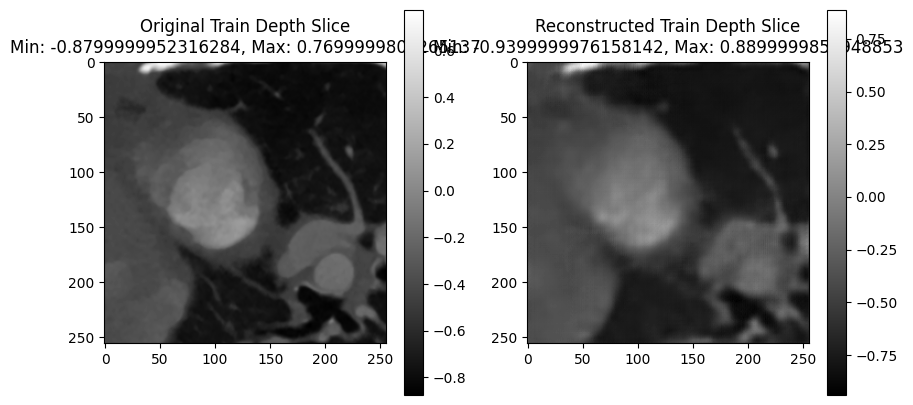

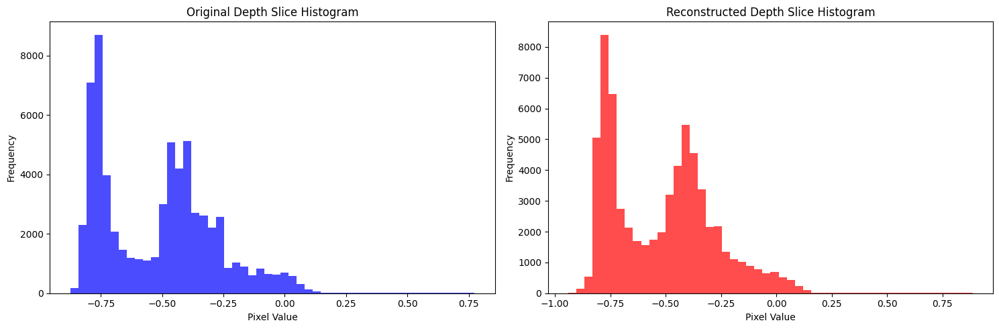

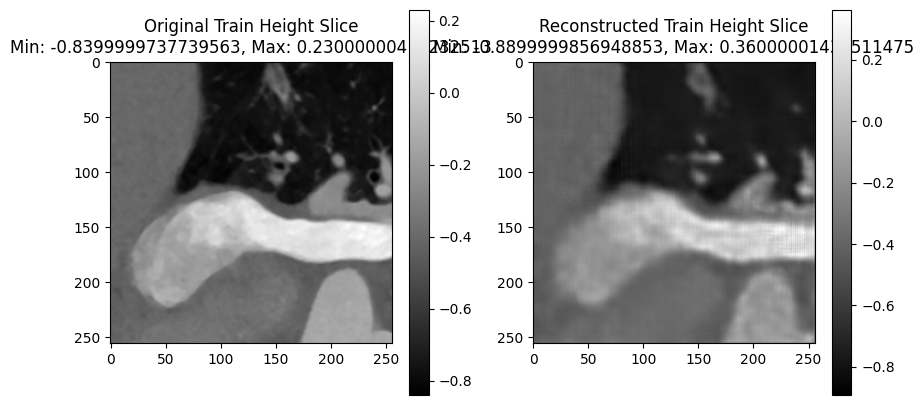

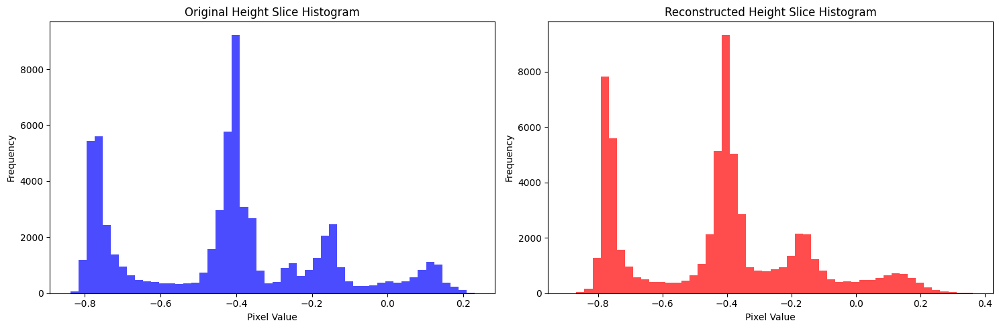

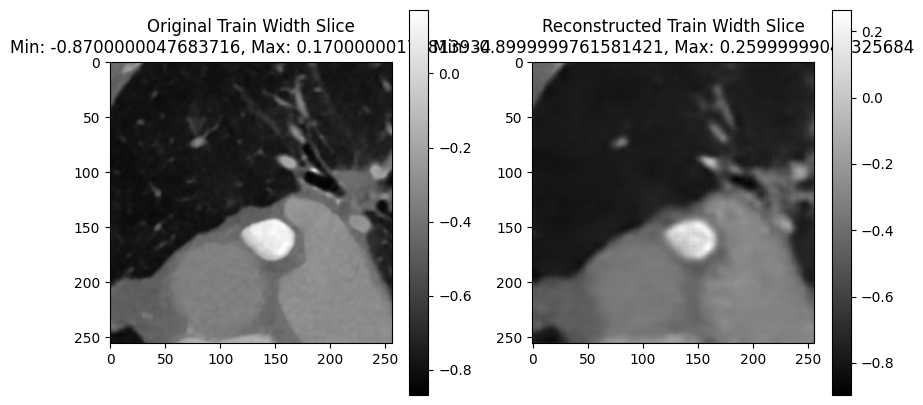

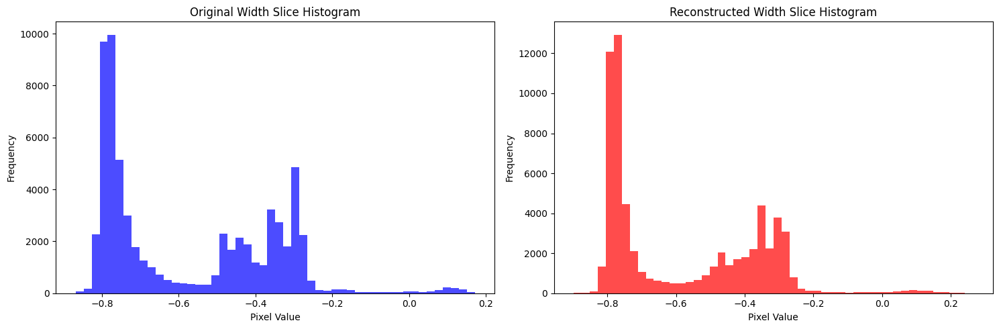

Validation: |          | 0/? [00:00<?, ?it/s]

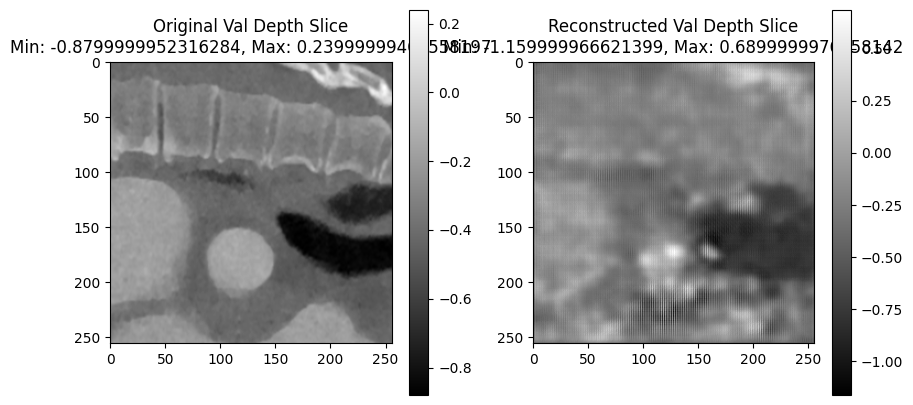

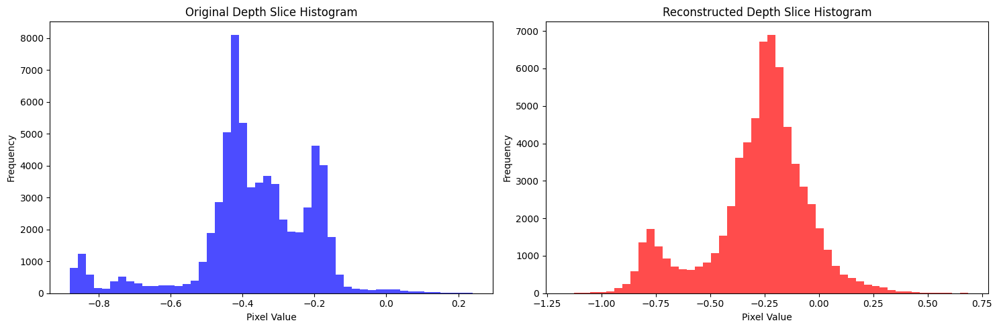

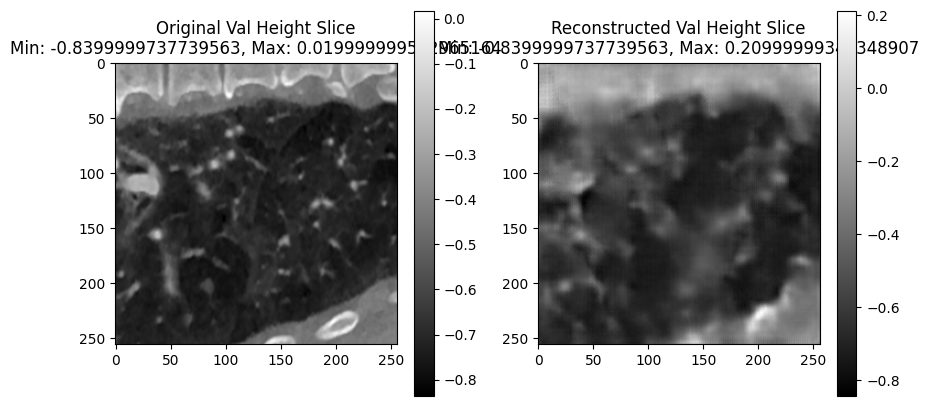

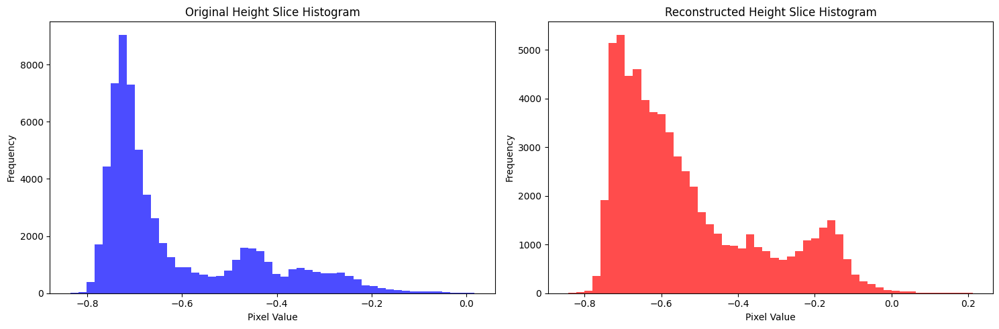

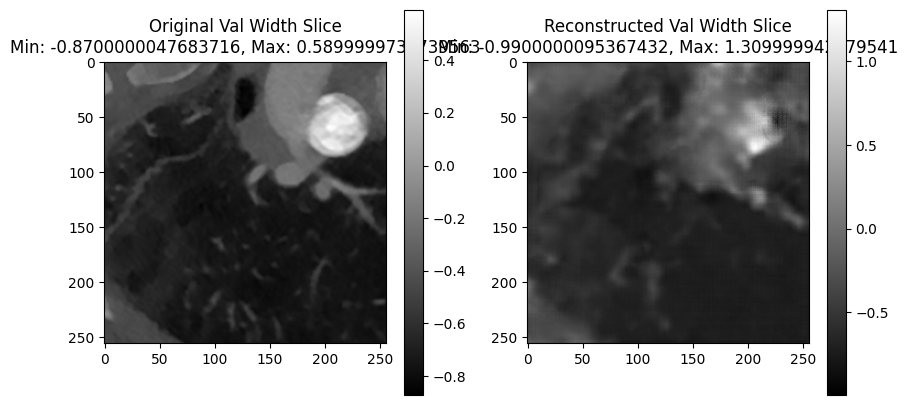

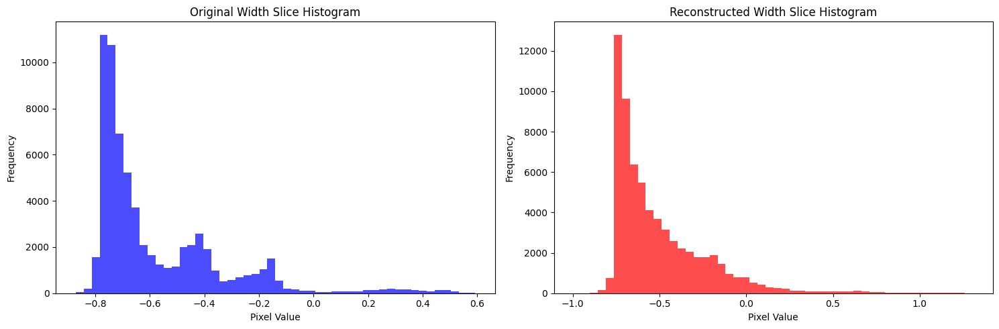

Time Spent 15182.13
Epoch: 1201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15194.20
Epoch: 1202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15206.44
Epoch: 1203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15218.48
Epoch: 1204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15230.25
Epoch: 1205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15241.97
Epoch: 1206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15253.74
Epoch: 1207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15265.57
Epoch: 1208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15277.30
Epoch: 1209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15289.36
Epoch: 1210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15301.71
Epoch: 1211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15314.07
Epoch: 1212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15326.31
Epoch: 1213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15338.56
Epoch: 1214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15350.89
Epoch: 1215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15362.61
Epoch: 1216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15374.32
Epoch: 1217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15386.13
Epoch: 1218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15397.84
Epoch: 1219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15409.90
Epoch: 1220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15422.01
Epoch: 1221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15434.49
Epoch: 1222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15446.73
Epoch: 1223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15458.48
Epoch: 1224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15470.31
Epoch: 1225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15482.44
Epoch: 1226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15494.31
Epoch: 1227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15506.06
Epoch: 1228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15517.91
Epoch: 1229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15529.97
Epoch: 1230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15542.21
Epoch: 1231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15554.45
Epoch: 1232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15566.81
Epoch: 1233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15579.05
Epoch: 1234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15591.31
Epoch: 1235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15603.67
Epoch: 1236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15615.91
Epoch: 1237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15628.15
Epoch: 1238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15640.37
Epoch: 1239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15652.72
Epoch: 1240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15664.93
Epoch: 1241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15677.17
Epoch: 1242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15689.53
Epoch: 1243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15701.77
Epoch: 1244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15714.01
Epoch: 1245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15726.25
Epoch: 1246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15738.61
Epoch: 1247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15750.85
Epoch: 1248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15763.10
Epoch: 1249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15775.29
Epoch: 1250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15787.02
Epoch: 1251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15799.10
Epoch: 1252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15811.36
Epoch: 1253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15823.71
Epoch: 1254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15835.92
Epoch: 1255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15848.01
Epoch: 1256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15860.26
Epoch: 1257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15872.62
Epoch: 1258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15884.87
Epoch: 1259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15896.61
Epoch: 1260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15908.44
Epoch: 1261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15920.16
Epoch: 1262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15931.88
Epoch: 1263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15943.61
Epoch: 1264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15955.59
Epoch: 1265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15967.83
Epoch: 1266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15980.07
Epoch: 1267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15992.43
Epoch: 1268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16004.68
Epoch: 1269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16016.71
Epoch: 1270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16028.44
Epoch: 1271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16040.27
Epoch: 1272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16051.99
Epoch: 1273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16063.72
Epoch: 1274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16075.72
Epoch: 1275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16087.97
Epoch: 1276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16100.21
Epoch: 1277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16112.45
Epoch: 1278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16124.81
Epoch: 1279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16136.84
Epoch: 1280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16148.57
Epoch: 1281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16160.65
Epoch: 1282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16172.84
Epoch: 1283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16185.09
Epoch: 1284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16196.85
Epoch: 1285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16209.13
Epoch: 1286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16221.36
Epoch: 1287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16233.60
Epoch: 1288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16245.85
Epoch: 1289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16257.72
Epoch: 1290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16269.44
Epoch: 1291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16281.53
Epoch: 1292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16293.88
Epoch: 1293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16305.74
Epoch: 1294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16317.46
Epoch: 1295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16329.16
Epoch: 1296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16341.34
Epoch: 1297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16353.59
Epoch: 1298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16365.83
Epoch: 1299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16377.96
Epoch: 1300


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16389.69
Epoch: 1301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16401.42
Epoch: 1302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16413.51
Epoch: 1303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16425.88
Epoch: 1304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16438.04
Epoch: 1305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16449.77
Epoch: 1306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16461.49
Epoch: 1307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16473.31
Epoch: 1308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16485.02
Epoch: 1309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16496.86
Epoch: 1310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16508.68
Epoch: 1311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16520.39
Epoch: 1312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16532.18
Epoch: 1313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16543.90
Epoch: 1314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16555.88
Epoch: 1315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16568.11
Epoch: 1316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16580.35
Epoch: 1317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16592.21
Epoch: 1318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16603.93
Epoch: 1319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16615.66
Epoch: 1320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16627.37
Epoch: 1321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16639.18
Epoch: 1322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16651.23
Epoch: 1323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16663.45
Epoch: 1324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16675.80
Epoch: 1325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16688.06
Epoch: 1326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16700.30
Epoch: 1327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16712.54
Epoch: 1328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16724.89
Epoch: 1329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16736.89
Epoch: 1330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16749.13
Epoch: 1331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16761.37
Epoch: 1332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16773.21
Epoch: 1333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16784.94
Epoch: 1334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16796.86
Epoch: 1335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16809.18
Epoch: 1336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16821.45
Epoch: 1337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16833.18
Epoch: 1338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16845.27
Epoch: 1339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16857.61
Epoch: 1340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16869.83
Epoch: 1341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16882.06
Epoch: 1342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16894.40
Epoch: 1343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16906.63
Epoch: 1344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16918.82
Epoch: 1345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16931.05
Epoch: 1346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16943.39
Epoch: 1347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16955.61
Epoch: 1348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16967.84
Epoch: 1349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16979.92
Epoch: 1350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16992.02
Epoch: 1351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17003.77
Epoch: 1352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17015.88
Epoch: 1353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17028.20
Epoch: 1354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17040.36
Epoch: 1355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17052.12
Epoch: 1356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17063.85
Epoch: 1357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17075.68
Epoch: 1358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17087.41
Epoch: 1359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17099.45
Epoch: 1360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17111.78
Epoch: 1361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17124.01
Epoch: 1362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17136.24
Epoch: 1363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17148.47
Epoch: 1364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17160.48
Epoch: 1365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17172.38
Epoch: 1366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17184.62
Epoch: 1367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17196.99
Epoch: 1368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17209.16
Epoch: 1369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17221.06
Epoch: 1370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17232.80
Epoch: 1371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17244.62
Epoch: 1372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17256.37
Epoch: 1373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17268.10
Epoch: 1374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17279.95
Epoch: 1375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17291.67
Epoch: 1376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17303.40
Epoch: 1377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17315.13
Epoch: 1378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17327.09
Epoch: 1379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17339.09
Epoch: 1380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17351.32
Epoch: 1381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17363.55
Epoch: 1382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17375.95
Epoch: 1383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17388.18
Epoch: 1384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17400.41
Epoch: 1385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17412.79
Epoch: 1386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17424.53
Epoch: 1387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17436.63
Epoch: 1388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17448.88
Epoch: 1389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17460.91
Epoch: 1390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17472.65
Epoch: 1391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17484.40
Epoch: 1392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17496.22
Epoch: 1393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17508.35
Epoch: 1394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17520.60
Epoch: 1395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17532.85
Epoch: 1396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17545.20
Epoch: 1397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17557.44
Epoch: 1398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17569.68
Epoch: 1399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17581.68
Epoch: 1400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17593.70
Epoch: 1401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17605.42
Epoch: 1402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17617.14
Epoch: 1403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17628.97
Epoch: 1404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17640.70
Epoch: 1405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17652.43
Epoch: 1406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17664.16
Epoch: 1407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17676.00
Epoch: 1408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17687.73
Epoch: 1409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17699.49
Epoch: 1410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17711.75
Epoch: 1411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17723.99
Epoch: 1412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17736.23
Epoch: 1413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17748.48
Epoch: 1414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17760.81
Epoch: 1415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17773.05
Epoch: 1416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17784.81
Epoch: 1417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17796.64
Epoch: 1418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17808.35
Epoch: 1419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17820.38
Epoch: 1420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17832.62
Epoch: 1421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17844.98
Epoch: 1422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17857.22
Epoch: 1423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17869.46
Epoch: 1424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17881.48
Epoch: 1425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17893.24
Epoch: 1426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17905.37
Epoch: 1427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17917.60
Epoch: 1428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17929.93
Epoch: 1429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17941.80
Epoch: 1430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17953.54
Epoch: 1431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17965.27
Epoch: 1432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17977.51
Epoch: 1433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17989.75
Epoch: 1434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18001.99
Epoch: 1435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18014.34
Epoch: 1436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18026.59
Epoch: 1437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18038.33
Epoch: 1438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18050.03
Epoch: 1439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18061.84
Epoch: 1440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18073.58
Epoch: 1441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18085.31
Epoch: 1442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18097.14
Epoch: 1443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18108.86
Epoch: 1444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18120.75
Epoch: 1445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18132.99
Epoch: 1446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18145.23
Epoch: 1447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18157.48
Epoch: 1448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18169.72
Epoch: 1449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18181.96
Epoch: 1450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18193.97
Epoch: 1451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18205.70
Epoch: 1452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18217.94
Epoch: 1453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18230.30
Epoch: 1454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18242.54
Epoch: 1455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18254.79
Epoch: 1456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18267.03
Epoch: 1457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18279.37
Epoch: 1458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18291.61
Epoch: 1459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18303.58
Epoch: 1460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18315.42
Epoch: 1461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18327.57
Epoch: 1462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18339.81
Epoch: 1463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18351.55
Epoch: 1464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18363.37
Epoch: 1465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18375.50
Epoch: 1466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18387.74
Epoch: 1467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18400.08
Epoch: 1468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18412.33
Epoch: 1469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18424.10
Epoch: 1470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18435.82
Epoch: 1471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18448.06
Epoch: 1472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18460.31
Epoch: 1473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18472.56
Epoch: 1474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18484.93
Epoch: 1475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18497.17
Epoch: 1476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18509.41
Epoch: 1477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18521.65
Epoch: 1478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18534.00
Epoch: 1479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18545.79
Epoch: 1480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18557.58
Epoch: 1481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18569.32
Epoch: 1482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18581.14
Epoch: 1483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18593.29
Epoch: 1484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18605.54
Epoch: 1485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18617.89
Epoch: 1486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18629.65
Epoch: 1487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18641.39
Epoch: 1488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18653.14
Epoch: 1489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18664.98
Epoch: 1490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18676.73
Epoch: 1491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18688.45
Epoch: 1492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18700.26
Epoch: 1493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18712.41
Epoch: 1494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18724.49
Epoch: 1495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18736.72
Epoch: 1496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18749.06
Epoch: 1497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18761.28
Epoch: 1498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18773.41
Epoch: 1499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18785.60
Epoch: 1500


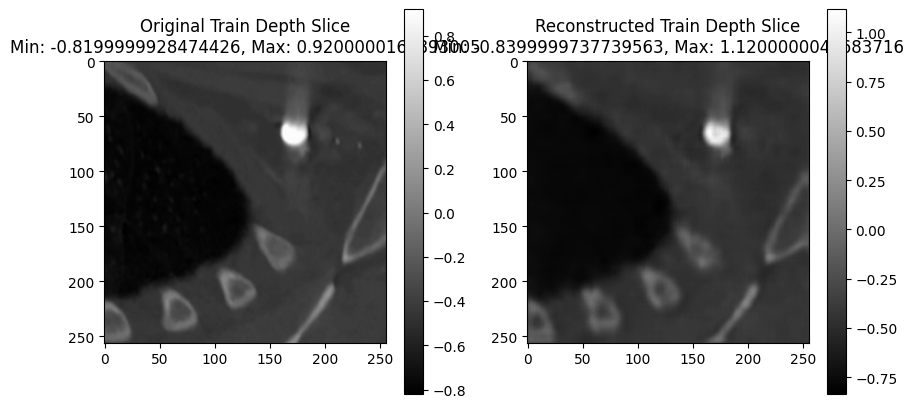

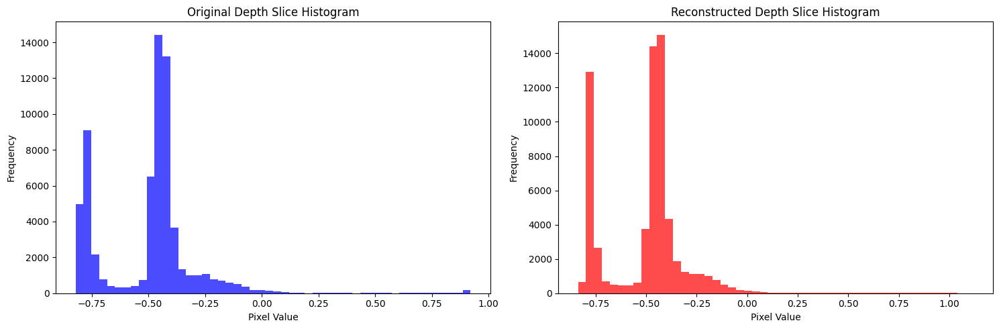

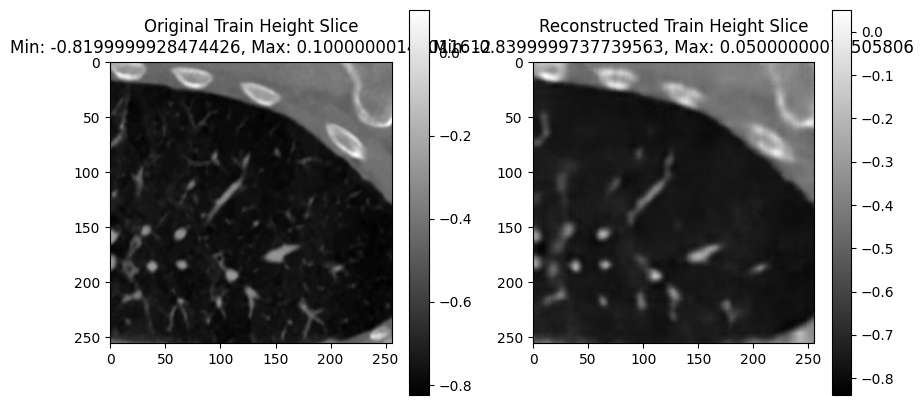

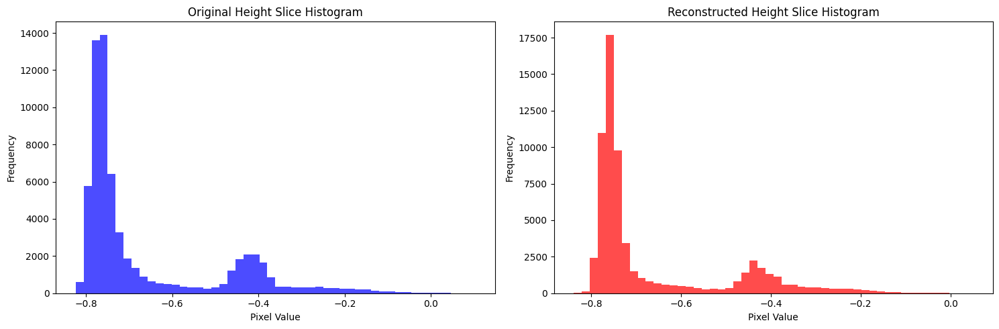

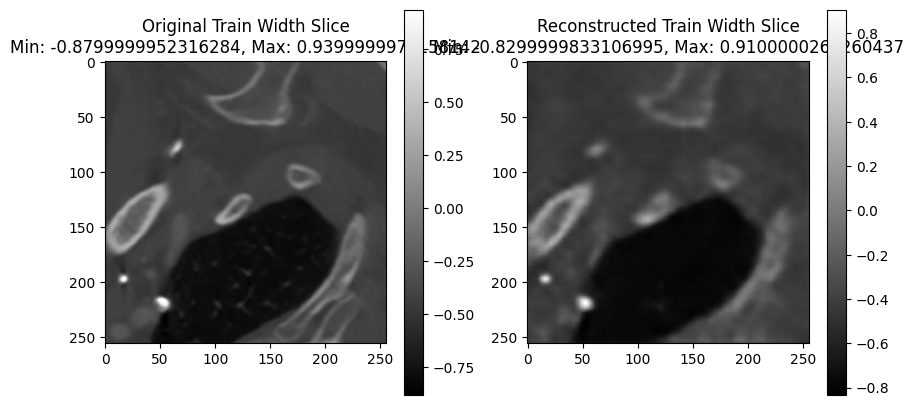

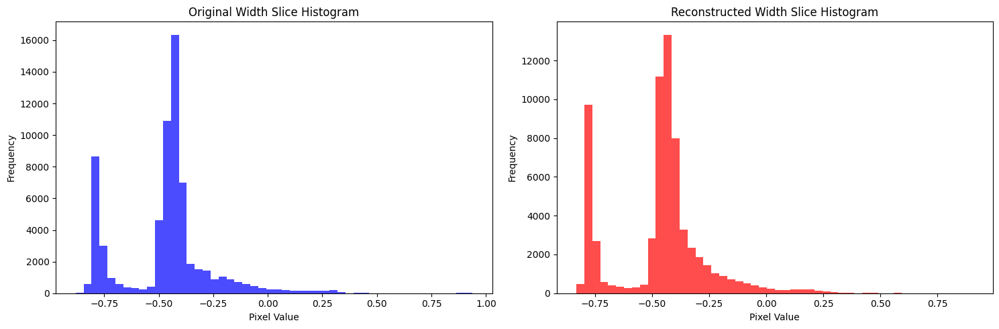

Validation: |          | 0/? [00:00<?, ?it/s]

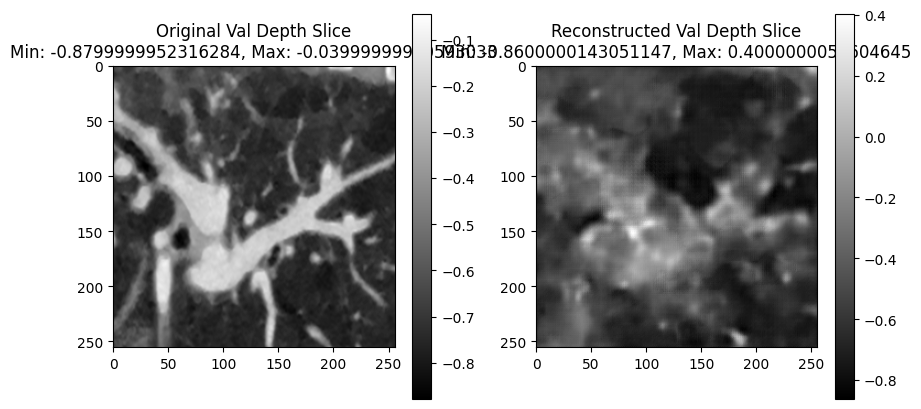

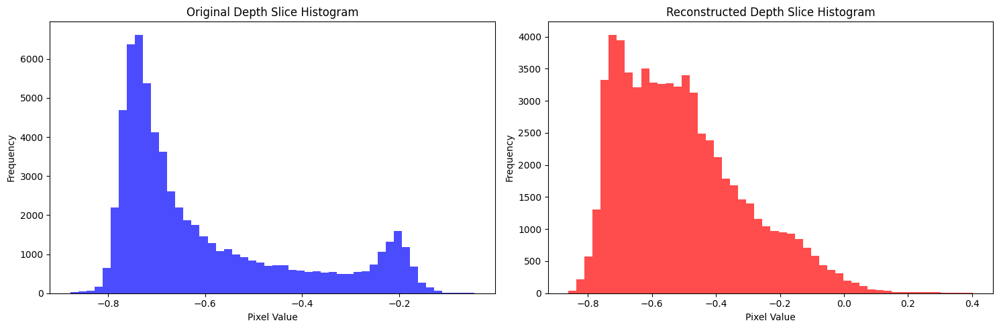

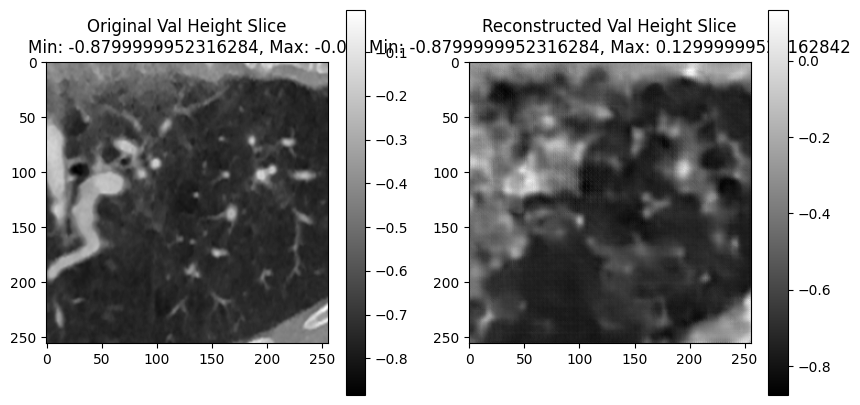

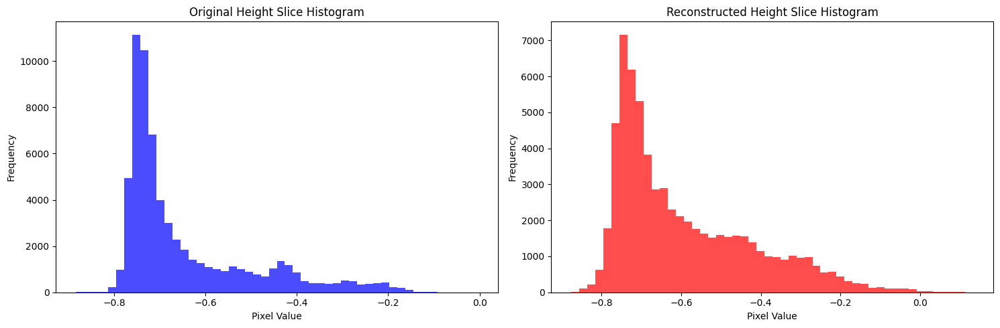

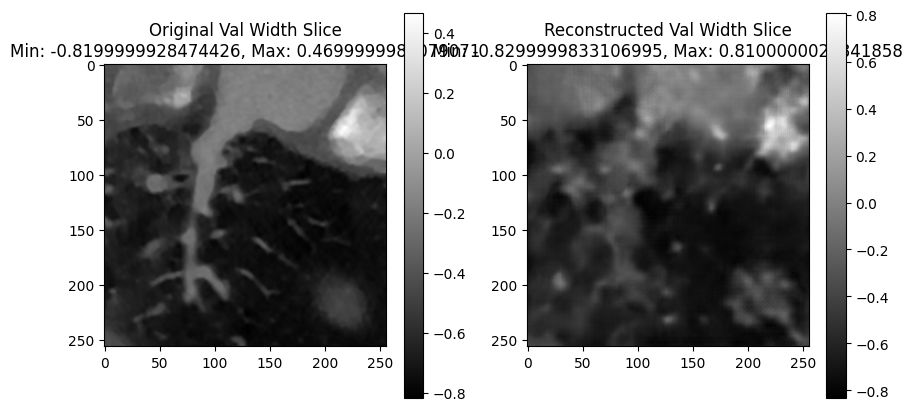

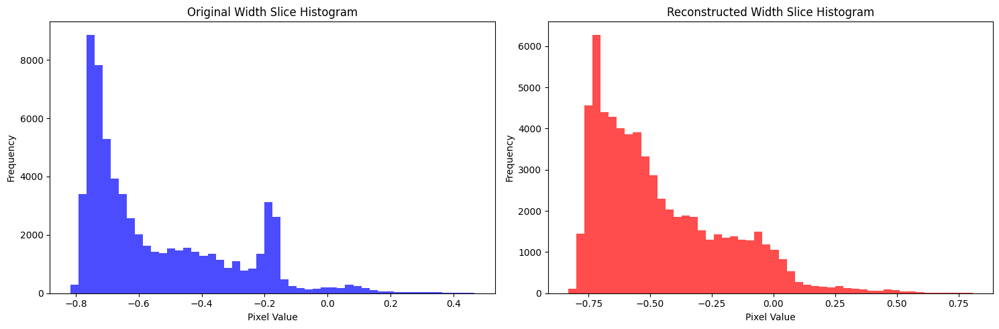

Time Spent 18804.59
Epoch: 1501


`Trainer.fit` stopped: `max_epochs=1501` reached.


FIT Profiler Report

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Action                                                                                                                                                           	|  Mean duration (s)	|  Num calls      	|  Total time (s) 	|  Percentage %   	|
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Total                                                                                                                                                            	|  -              	|  1086857      

In [5]:
# Initialize model and start training
ExperimentDescription = 'I-AE Job18 4C Loss'
ShowInterval = 300
model = AutoEncoderModel()
trainer.fit(model, train_dataloader, val_dataloader)
# torch.save(model.state_dict(), folder_path + '/aeSSIM.pth')